In [1]:
from typing import List, Optional, NamedTuple, Literal

import collections
import itertools
import functools
import json
import math
import os
import sys
import pathlib
import datetime
import hashlib

import anndata as ad
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.cluster.hierarchy
import statsmodels.stats.multitest
import cellrank

In [2]:
sys.path.insert(0, "../lib/")

In [3]:
import sc_utils

In [4]:
%config InlineBackend.figure_format = "retina"

In [5]:
mpl.rcParams["figure.figsize"] = (10, 8)
cellrank.settings.verbosity = 2
pd.options.display.max_columns = 200

In [6]:
FONT_DIR = '/projects/b1038/Pulmonary/nmarkov/fonts'
for f in os.listdir(FONT_DIR):
    if f.endswith('.ttf'):
        mpl.font_manager.fontManager.addfont(f'{FONT_DIR}/{f}')

In [7]:
mpl.rcParams["font.family"] = "Arial"
mpl.rcParams["pdf.fonttype"] = 42
# plt.rcParams['figure.constrained_layout.use'] = False
# mpl.rcParams['mathtext.default'] = 'regular'

In [8]:
from IPython.display import display, HTML
display(HTML('<style>.jp-OutputArea-output {display:flex}</style>'))

In [9]:
DATA = pathlib.Path('../../data/31_bal-object/')

In [10]:
ds_processed = sc.read_h5ad(DATA / '03_bal-object/03_bal-object.h5ad')

In [11]:
ds_processed.obs.cell_type = ds_processed.obs.cell_type.astype(str).replace({
    'MoAM-3 mature': 'MoAM-2 mature',
    'MoAM-4 profibrotic': 'MoAM-3 profibrotic',
    'gd/NKT cells': 'NK + γδT cells',
    'Perivascular macrophages': 'Interstitial macrophages',
}).astype('category')

In [12]:
rng = np.random.default_rng(seed=101)
ds_processed.uns['cell_type_colors'] = list(rng.permutation(
    ds_processed.uns['cell_type_colors']
))

In [13]:
cellrank._utils._linear_solver._is_petsc_slepc_available()

True

In [14]:
def get_color_annotations(df, mapping):
    result = []
    for column, palette in mapping.items():
        values = df[column].unique()
        if pd.api.types.is_categorical_dtype(df[column]):
            values = df[column].cat.categories
        lut = dict(zip(values, sns.color_palette(palette, n_colors=values.size).as_hex()))
        result.append(df[column].map(lut))
    return pd.concat(result, axis=1)

In [15]:
ds = ds_processed

In [16]:
ds

AnnData object with n_obs × n_vars = 197208 × 1000
    obs: 'Study', 'Sample', 'Sample ID', 'External Sample ID', 'Status', 'Patient', 'Age', 'Sex', 'Smoking status', 'Race', 'BMI', 'Type', 'Tissue location', 'Additional data', 'Chemistry', 'Protocol', 'Fastq', 'Genome build', 'Directory', 'Doublet threshold', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'cell_type'
    var: 'feature_types', 'n_counts', 'mito', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'cell_type_colors', 'hvg', 'leiden', 'neighbors', 'rank_genes_groups', 'umap'
    obsm: 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

# 1. Myeloid object excluding DCs PAGA and Diffusion componets

Let's exclude DCs

In [17]:
myeloid = ds[ds.obs.cell_type.str.contains("TRAM|MoAM|macrophage|Mono", regex=True)]

In [18]:
myeloid = myeloid[myeloid.obs.cell_type.ne('Proliferating macrophages'), :].copy()

In [19]:
sc.pp.neighbors(myeloid, use_rep='X_scVI')

In [20]:
sc.tl.diffmap(myeloid)

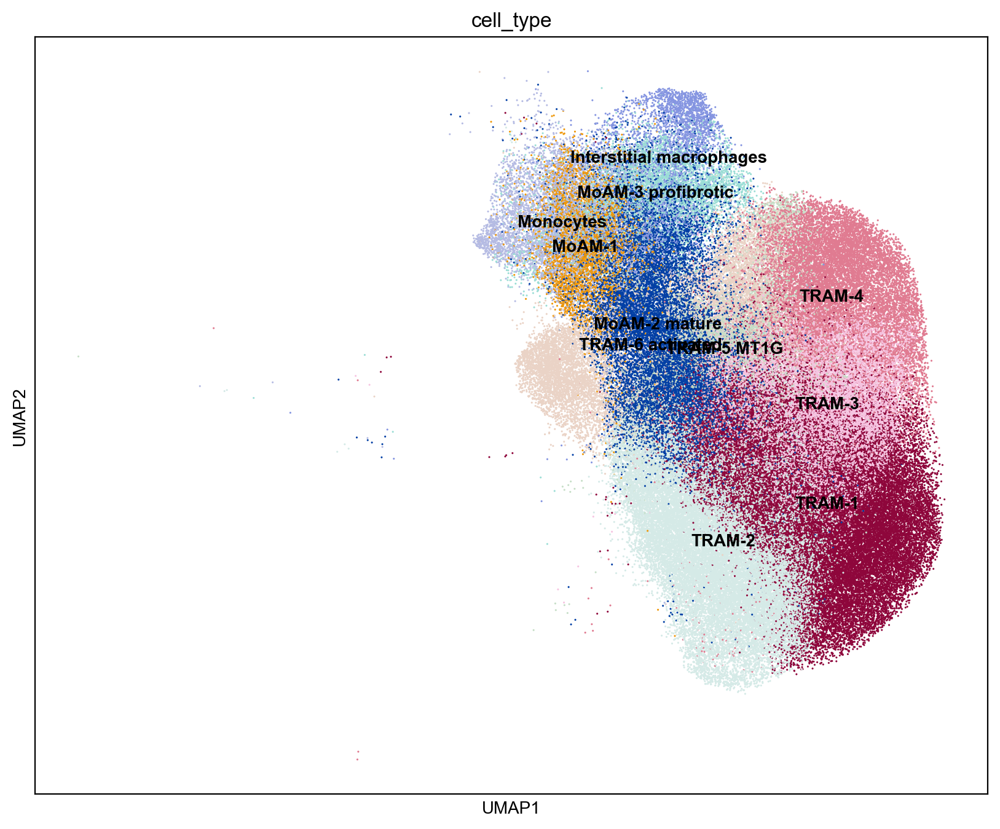

In [21]:
sc.pl.umap(myeloid, color=["cell_type"], size=5, legend_loc="on data")

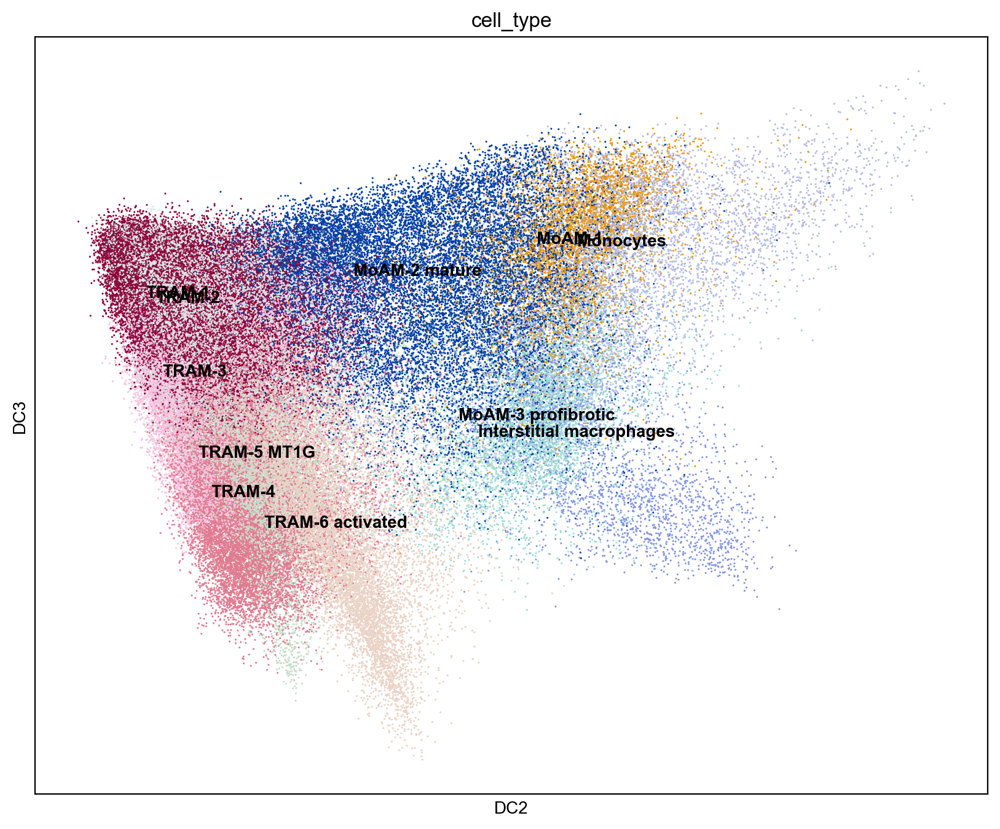

In [22]:
sc.pl.diffmap(myeloid, color=["cell_type"], dimensions=(1, 2), size=5, legend_loc="on data")

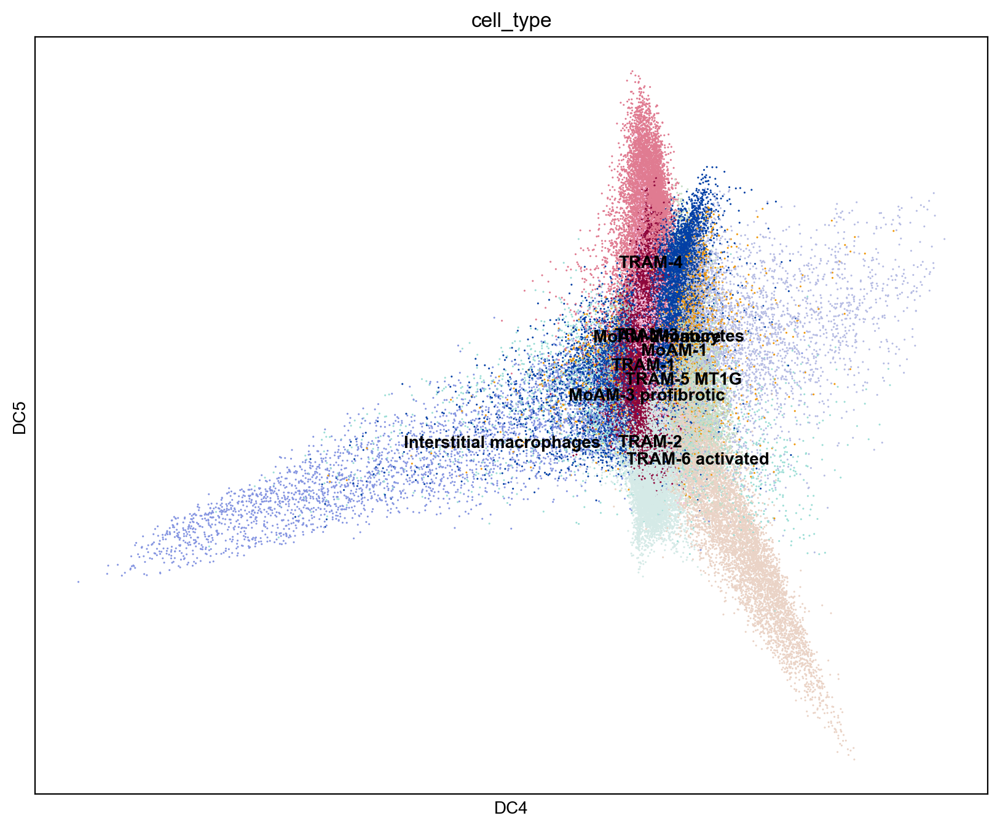

In [23]:
sc.pl.diffmap(myeloid, color=["cell_type"], dimensions=(3, 4), size=5, legend_loc="on data")

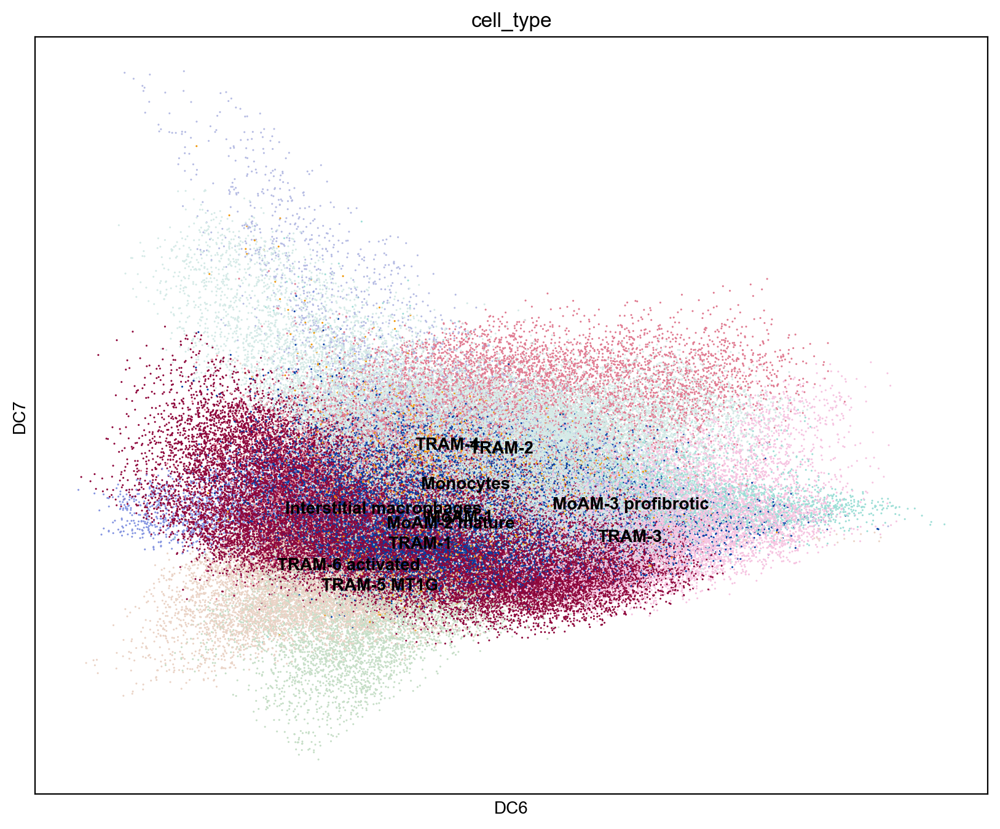

In [24]:
sc.pl.diffmap(myeloid, color=["cell_type"], dimensions=(5, 6), size=5, legend_loc="on data")

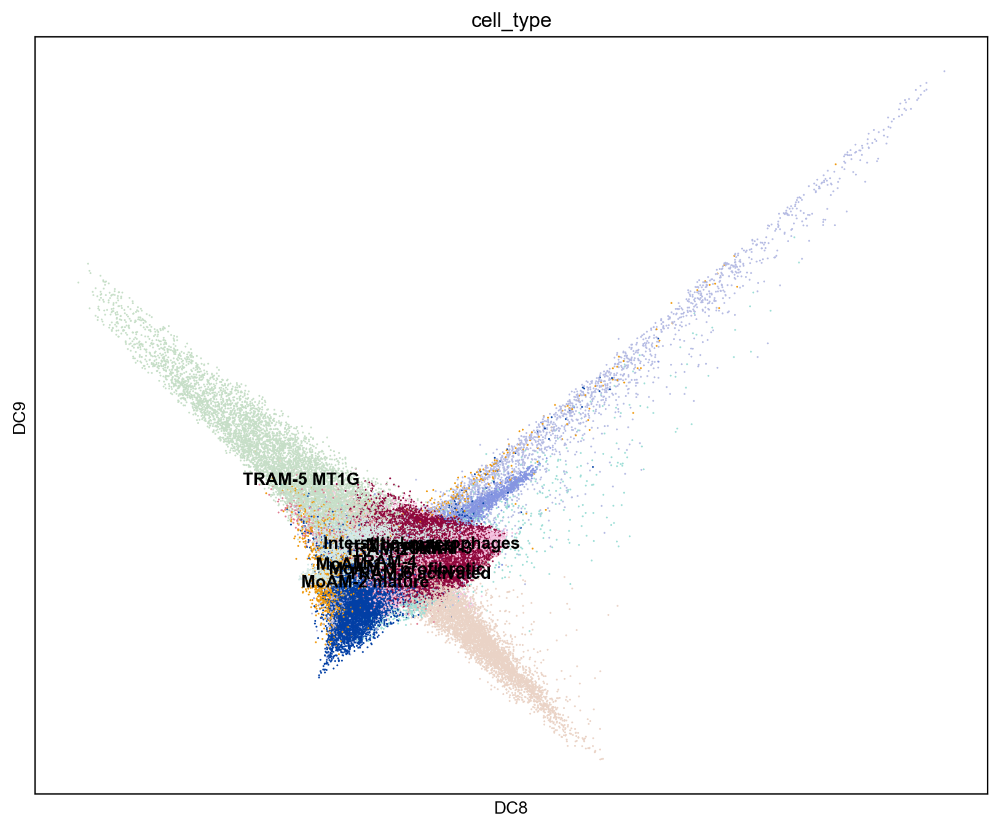

In [25]:
sc.pl.diffmap(myeloid, color=["cell_type"], dimensions=(7, 8), size=5, legend_loc="on data")

Diffusion components are not straightforward, especially 2 & 3

DC2 seems to be Monocyte to TRAM differentiation, while DC3 seems to be a sort of activation.

Let's take most extreme Monocyte with the max DC2, and use it as root

In [26]:
root_idx = myeloid.obsm['X_diffmap'][:, 1].argmax()

In [27]:
myeloid.obs.cell_type[root_idx]

'Monocytes'

In [28]:
myeloid.uns['iroot'] = root_idx

## Pseudotime

In [29]:
sc.tl.dpt(myeloid)

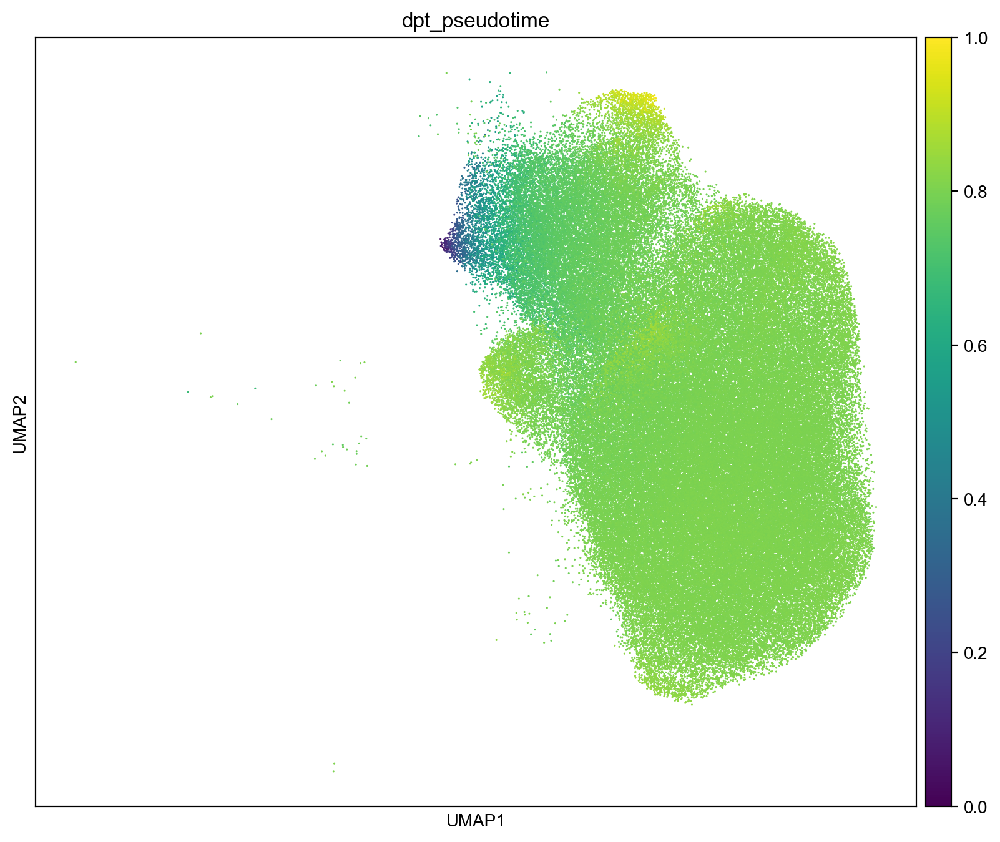

In [30]:
sc.pl.umap(myeloid, color='dpt_pseudotime', size=5)

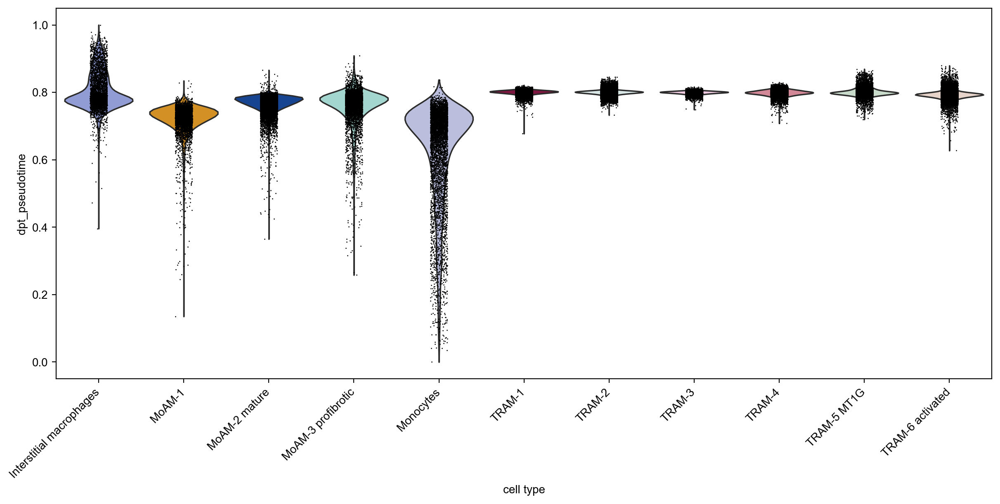

In [31]:
fig, ax = plt.subplots(figsize=(12, 6), constrained_layout=True)
sc.pl.violin(myeloid, keys='dpt_pseudotime', groupby='cell_type', ax=ax, show=False)
trans = mpl.transforms.Affine2D().translate(8, 0)
for t in ax.get_xticklabels():
    t.set_rotation(45)
    t.set_ha('right')
    t.set_transform(t.get_transform() + trans)

This pseudotime seems suboptimal, because the most change is in Monocytes, and sparse along the `0–0.5` range, and `0.9–1` range is exclusively Perivascular macrophages.

However, we will work with this right now, because exploring other pseudotime algorithms (see https://www.nature.com/articles/s41587-019-0071-9) is time-consuming.

## Cellrank transition kernel based on pseudotime

In [32]:
pk = cellrank.kernels.PseudotimeKernel(myeloid, time_key='dpt_pseudotime')
pk.compute_transition_matrix()

Computing transition matrix based on pseudotime


100%|██████████| 150801/150801 [00:13<00:00, 11550.41cell/s]


    Finish (0:00:20)


PseudotimeKernel[n=150801, dnorm=False, scheme='hard', frac_to_keep=0.3]

Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:25)


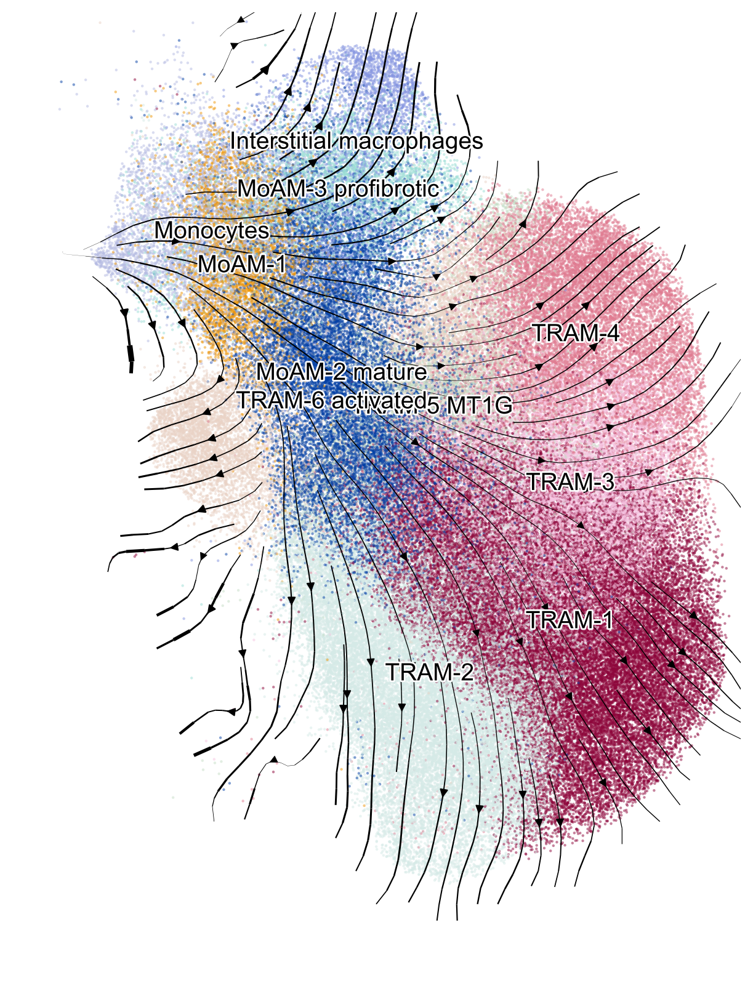

In [33]:
fig, ax = plt.subplots(figsize=(6, 8), constrained_layout=True)
pk.plot_projection(
    basis='umap',
    color='cell_type',
    ax=ax,
    show=False,
    legend_fontweight='normal',
    legend_fontsize=14,
    legend_fontoutline=2,
    title='',
    size=10,
    linewidth=2,
    alpha=0.5
)
ax.set_xlim(3.5)
# ax.set_title('')
ax.collections[0].set_rasterized(True)
ax.collections[1].set_rasterized(True)
fig.savefig('00_figures/Figure_5C_cellrank_streams.pdf', dpi=300)

## Coarse-graining the transition matrix

In [34]:
g = cellrank.estimators.GPCCA(pk)
print(g)

GPCCA[kernel=PseudotimeKernel[n=150801], initial_states=None, terminal_states=None]


In [35]:
g.compute_schur(n_components=40)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[16, 33, 35, 38]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:14)


GPCCA[kernel=PseudotimeKernel[n=150801], initial_states=None, terminal_states=None]

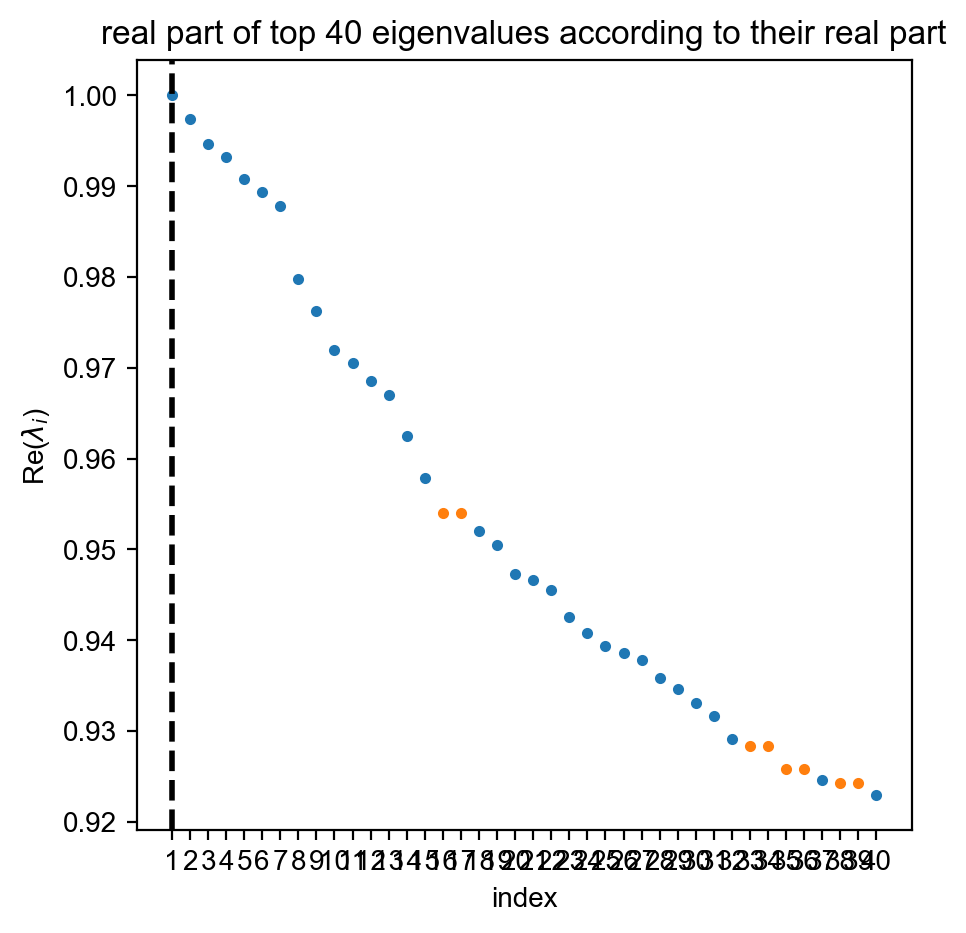

In [36]:
g.plot_spectrum(real_only=True)

Here we select 7 macrostates (eigenvalues), because of the (relatively) large gap after it.

In [37]:
g.compute_macrostates(n_states=7, cluster_key='cell_type', n_cells=100)

Computing `7` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:23)


GPCCA[kernel=PseudotimeKernel[n=150801], initial_states=None, terminal_states=None]

/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c

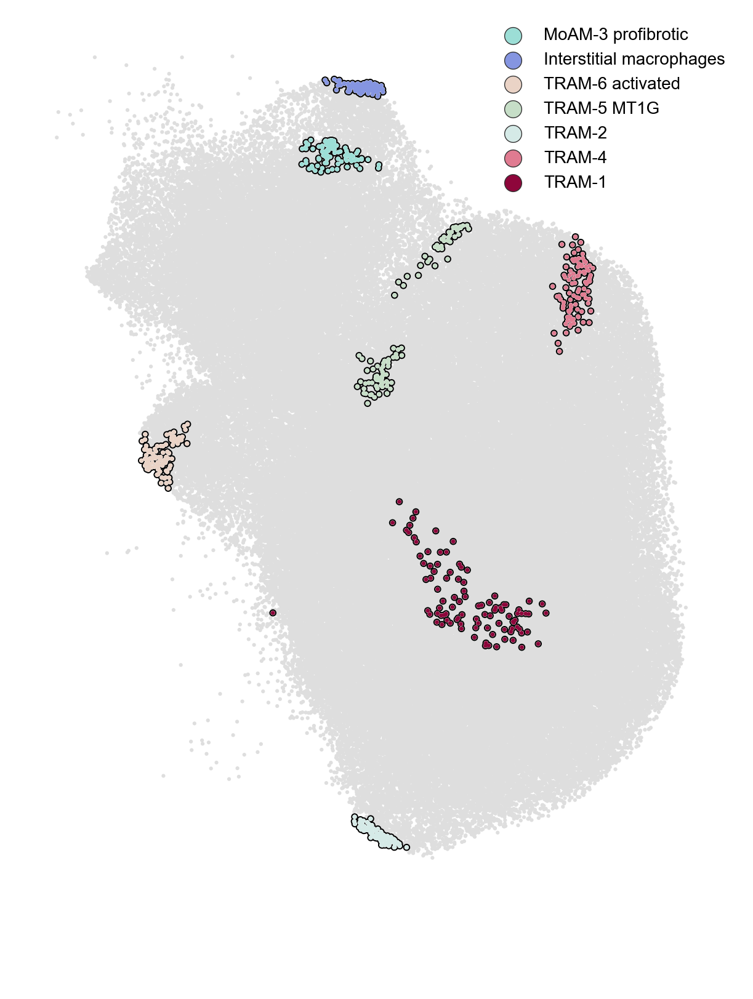

In [38]:
fig, ax = plt.subplots(figsize=(6, 8), constrained_layout=True)
g.plot_macrostates(
    which='all',
    legend_loc='right',
    s=20,
    ax=ax,
    show=False,
    title=''
)
ax.set_xlim(3.5)
ax.collections[0].set_rasterized(True)
h, l = ax.get_legend_handles_labels()
ax.legend(
    handles=h,
    labels=l,
    loc='upper right',
    frameon=False
)
for lh in ax.legend_.legend_handles:
    lh.set(alpha=1, sizes=[100], ec='#333', lw=0.5)
# fig.savefig('00_figures/Figure_5D_stable_states.pdf', dpi=300)

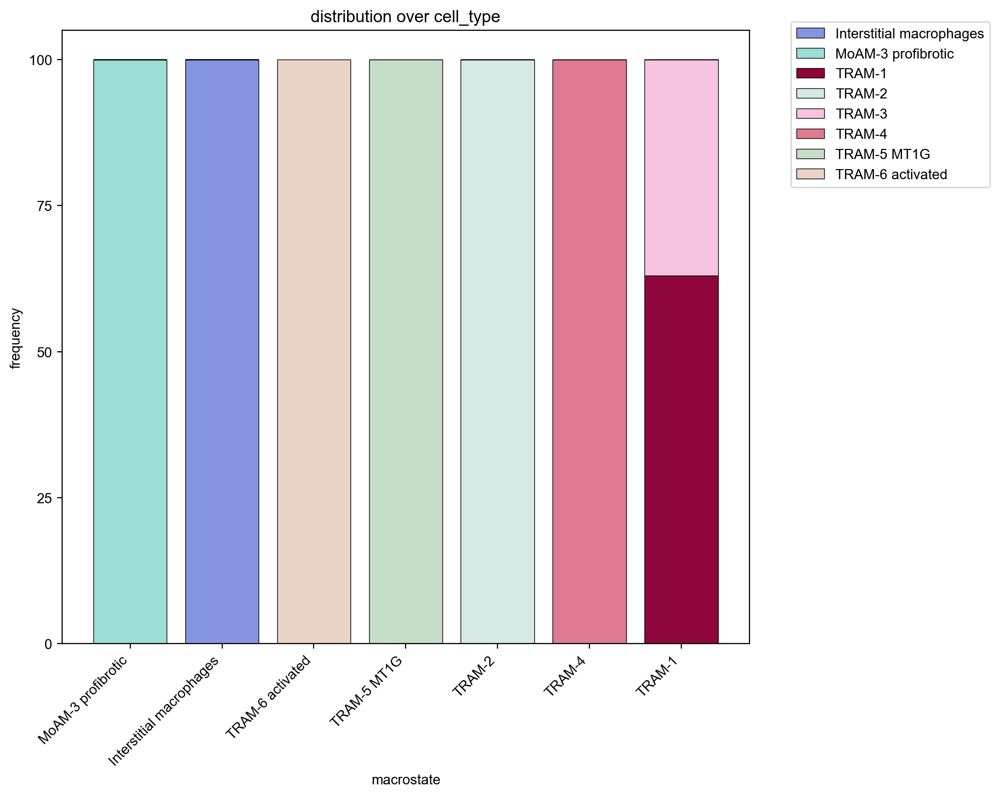

In [39]:
g.plot_macrostate_composition(key='cell_type')

In [40]:
myeloid.uns['Status_colors'] = ['royalblue', 'firebrick']
myeloid.obs.Status = myeloid.obs.Status.replace({
    'SSc': 'SSc-ILD',
    'control': 'Control'
})
myeloid.obs.Status = pd.Categorical(myeloid.obs.Status, categories=['Control', 'SSc-ILD'])

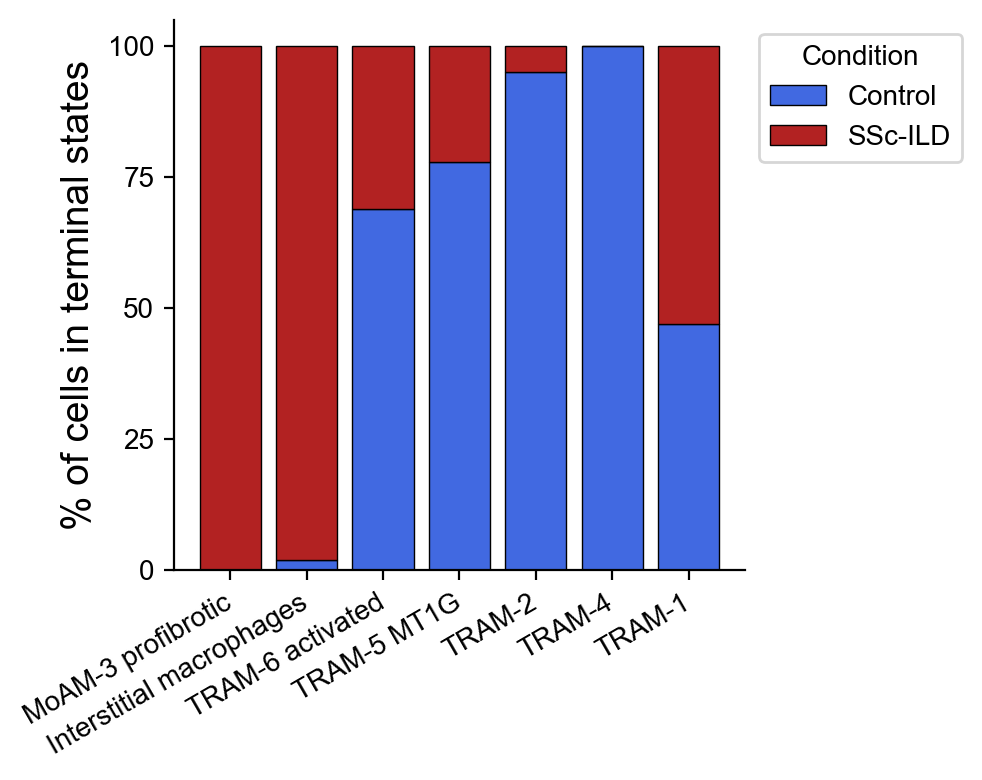

In [41]:
ax = g.plot_macrostate_composition(key='Status', show=False, figsize=(5, 4))
ax.set_title('')
ax.set_ylabel('% of cells in terminal states', size=14)
h, l = ax.get_legend_handles_labels()
ax.legend(handles=h, labels=l, title='Condition', loc='upper left', bbox_to_anchor=(1, 1))
trans = mpl.transforms.Affine2D().translate(6, 0)
for t in ax.xaxis.get_ticklabels():
    t.set_ha('right')
    t.set_transform(t.get_transform() + trans)
    t.set_rotation(30)
ax.set_xlabel('')
ax.spines[['top', 'right']].set_visible(False)
# ax.figure.savefig('00_figures/Figure_S5A_term_states_by_cond.pdf')

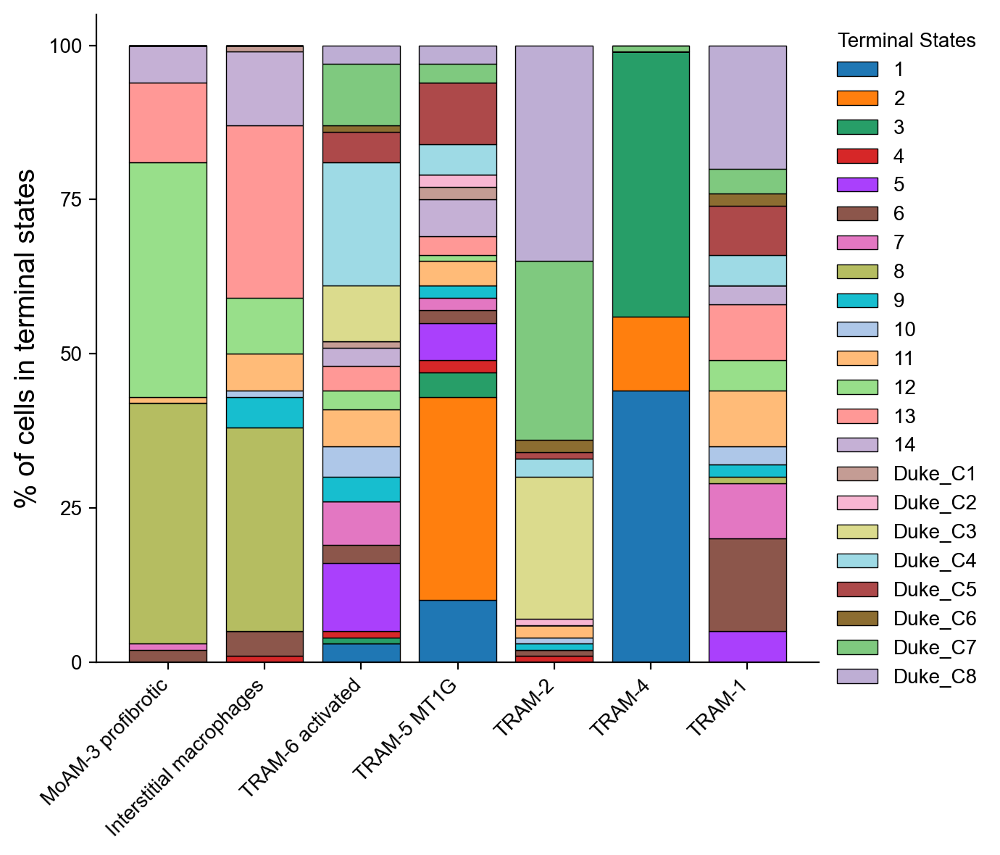

In [42]:
# Plot macrostate composition by patient
ax = g.plot_macrostate_composition(key='Patient', show=False, figsize=(7, 6))
ax.set_title('')
ax.set_ylabel('% of cells in terminal states', size=14)
ax.set_xlabel('')

# Rotate x-axis labels for better readability
trans = mpl.transforms.Affine2D().translate(6, 0)
for t in ax.xaxis.get_ticklabels():
    t.set_ha('right')
    t.set_transform(t.get_transform() + trans)
    t.set_rotation(45)

# Clean up plot appearance
ax.spines[['top', 'right']].set_visible(False)
h, l = ax.get_legend_handles_labels()
ax.legend(handles=h, labels=l, title='Terminal States',
          loc='upper left', bbox_to_anchor=(1, 1), frameon=False)

# Save figure
# fig.savefig('00_figures/Figure_S5B_term_states_by_patient.pdf', bbox_inches='tight')

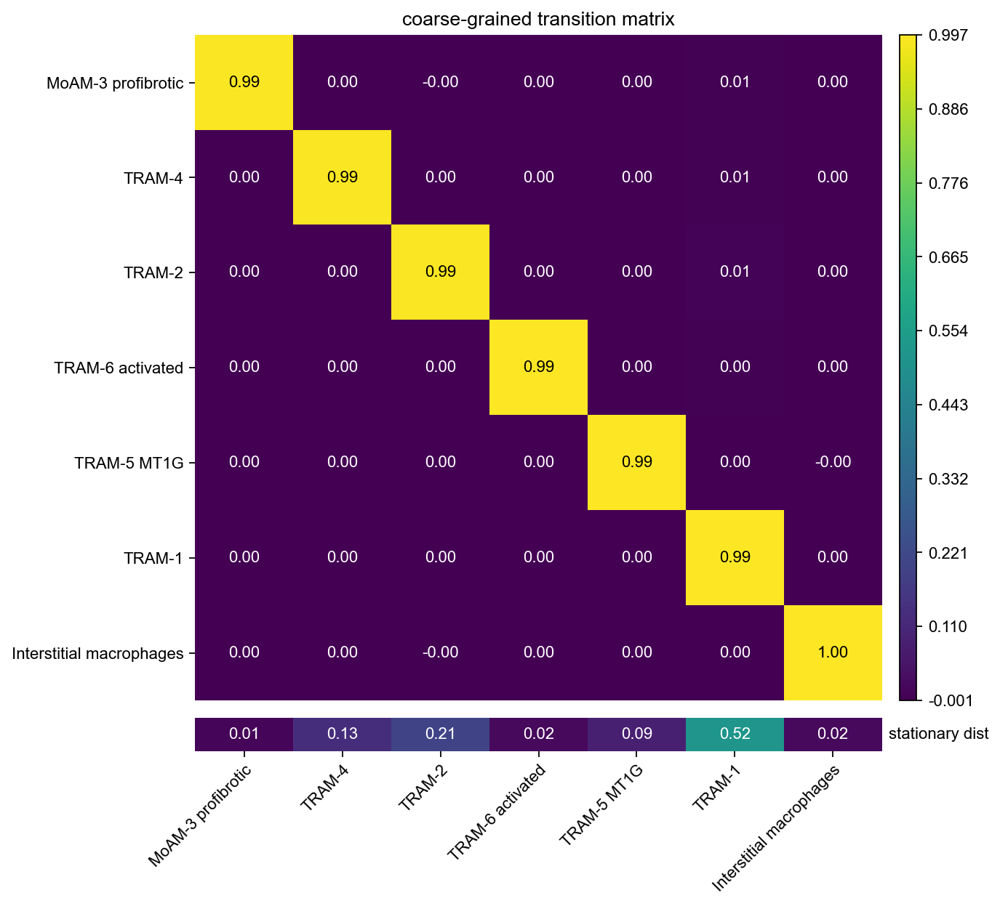

In [43]:
g.plot_coarse_T()

In [44]:
g.predict_terminal_states(n_cells=100)

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


GPCCA[kernel=PseudotimeKernel[n=150801], initial_states=None, terminal_states=['Interstitial macrophages', 'MoAM-3 profibrotic', 'TRAM-1', 'TRAM-2', 'TRAM-4', 'TRAM-5 MT1G', 'TRAM-6 activated']]

/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c

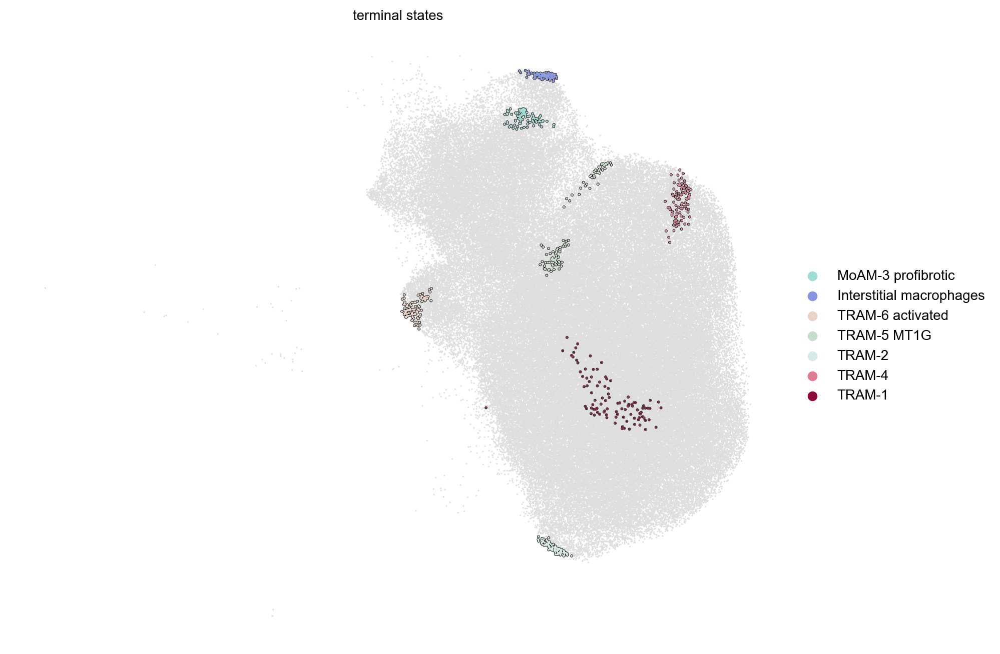

In [45]:
g.plot_macrostates(which='terminal', legend_loc='right', s=5)

All of these states are terminal states of differentiation. Let's merge TRAMs together, and so keep 4 lineages:

1. MoAM-4 profibrotic
2. Perivascular macrophages
3. TRAM-6 activated
4. TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G

In [46]:
g.set_terminal_states(states=[
    'MoAM-3 profibrotic',
    'Interstitial macrophages',
    'TRAM-6 activated',
    'TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G'
])

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


GPCCA[kernel=PseudotimeKernel[n=150801], initial_states=None, terminal_states=['Interstitial macrophages', 'MoAM-3 profibrotic', 'TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G', 'TRAM-6 activated']]

## Fate probabilities towards the 4 lineages

In [47]:
g.compute_fate_probabilities()

Computing fate probabilities


100%|██████████| 4/4 [00:02<00:00,  1.50/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:02)


In [48]:
myeloid.obs['cell_type_state'] = myeloid.obs.cell_type.astype(str) + '_' + myeloid.obs.Status.astype(str)
myeloid.obs.cell_type_state = pd.Categorical(myeloid.obs.cell_type_state)

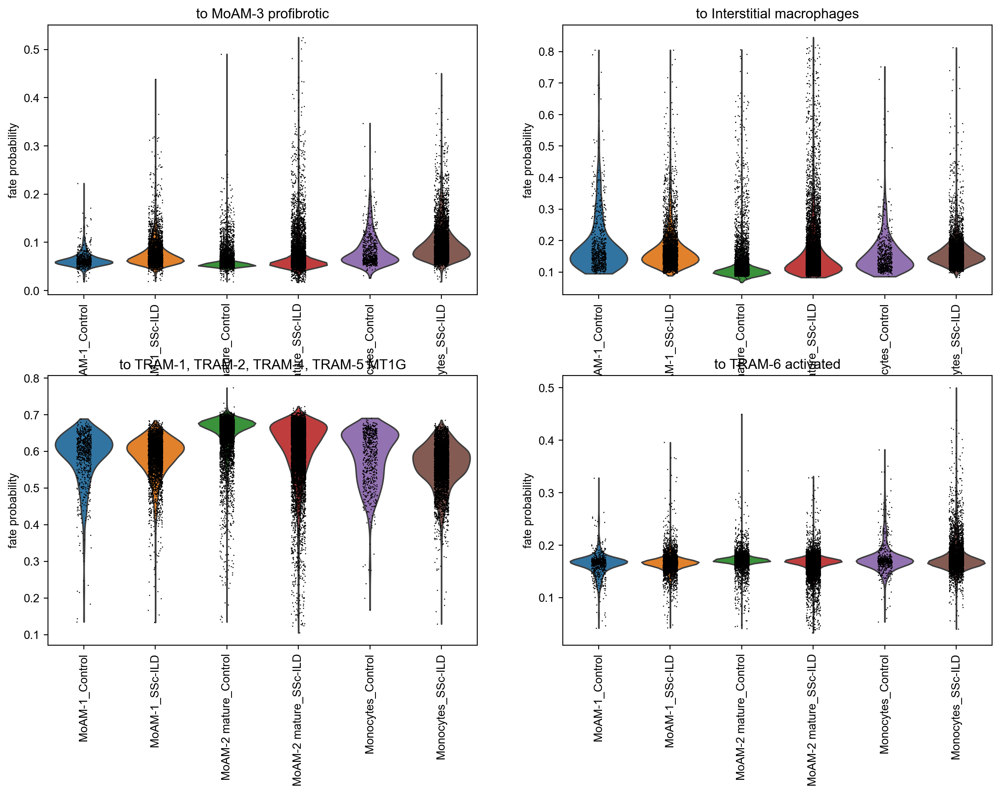

In [52]:
cellrank.pl.aggregate_fate_probabilities(
    myeloid,
    mode='violin',
    lineages=[
        'MoAM-3 profibrotic', 'Interstitial macrophages',
        'TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G', 'TRAM-6 activated'
    ],
    cluster_key='cell_type_state',
    clusters=[
        'Monocytes_Control', 'Monocytes_SSc-ILD',
        'MoAM-1_Control', 'MoAM-1_SSc-ILD',
        'MoAM-2 mature_Control', 'MoAM-2 mature_SSc-ILD',
    ],
    ncols=2
)

## Lineage drivers (by correlation)

### MoAM-4 profibrotic

In [53]:
moam_4_drivers = g.compute_lineage_drivers(
    lineages=['MoAM-3 profibrotic'],
    cluster_key='cell_type_state',
    clusters=[
        'Monocytes_Control', 'Monocytes_SSc-ILD',
        'MoAM-1_Control', 'MoAM-1_SSc-ILD',
        'MoAM-2 mature_Control', 'MoAM-2 mature_SSc-ILD',
    ],
    use_raw=True
)

Adding `adata.raw.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:01)


In [54]:
moam_4_drivers.head(20)

,MoAM-3 profibrotic_corr,MoAM-3 profibrotic_pval,MoAM-3 profibrotic_qval,MoAM-3 profibrotic_ci_low,MoAM-3 profibrotic_ci_high
C15orf48,0.437066,0.0,0.0,0.427324,0.446706
PLA2G7,0.413001,0.0,0.0,0.403016,0.422887
SGK1,0.370091,0.0,0.0,0.359707,0.380384
EMP1,0.361937,0.0,0.0,0.351482,0.372302
SDC2,0.347637,0.0,0.0,0.337062,0.358125
CCL2,0.311406,0.0,0.0,0.300548,0.322183
EMP3,0.309715,0.0,0.0,0.298845,0.320505
CD9,0.276932,0.0,0.0,0.265835,0.287955
LIMS1,0.273436,0.0,0.0,0.262317,0.284483
IL4I1,0.256252,0.0,0.0,0.245026,0.267410


### Perivascular macrophages

In [55]:
perivascular_drivers = g.compute_lineage_drivers(
    lineages=['Interstitial macrophages'],
    cluster_key='cell_type_state',
    clusters=[
        'Monocytes_Control', 'Monocytes_SSc-ILD',
        'MoAM-1_Control', 'MoAM-1_SSc-ILD',
        'MoAM-2 mature_Control', 'MoAM-2 mature_SSc-ILD',
    ],
    use_raw=True
)

Adding `adata.raw.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:01)


In [56]:
perivascular_drivers.head(20)

,Interstitial macrophages_corr,Interstitial macrophages_pval,Interstitial macrophages_qval,Interstitial macrophages_ci_low,Interstitial macrophages_ci_high
LGMN,0.342603,0.000000e+00,0.000000e+00,0.331987,0.353133
RNASE1,0.314027,0.000000e+00,0.000000e+00,0.303189,0.324784
FPR3,0.304682,0.000000e+00,0.000000e+00,0.293775,0.315509
MARCKS,0.296387,0.000000e+00,0.000000e+00,0.285421,0.307274
ZFP36L1,0.261523,0.000000e+00,0.000000e+00,0.250329,0.272648
MS4A6A,0.256153,0.000000e+00,0.000000e+00,0.244925,0.267311
CLEC10A,0.243986,0.000000e+00,0.000000e+00,0.232688,0.255219
A2M,0.240966,0.000000e+00,0.000000e+00,0.229650,0.252217
FOLR2,0.240963,0.000000e+00,0.000000e+00,0.229647,0.252214
F13A1,0.237007,0.000000e+00,0.000000e+00,0.225669,0.248281


### TRAM drivers

In [57]:
tram_drivers = g.compute_lineage_drivers(
    lineages=['TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G'],
    cluster_key='cell_type_state',
    clusters=[
        'Monocytes_Control', 'Monocytes_SSc-ILD',
        'MoAM-1_Control', 'MoAM-1_SSc-ILD',
        'MoAM-2 mature_Control', 'MoAM-2 mature_SSc-ILD',
    ],
    use_raw=True
)

Adding `adata.raw.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:01)


In [58]:
tram_drivers.head(20)

,"TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G_corr","TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G_pval","TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G_qval","TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G_ci_low","TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G_ci_high"
MCEMP1,0.468830,0.0,0.0,0.459431,0.478123
RETN,0.453814,0.0,0.0,0.444250,0.463274
INHBA,0.443279,0.0,0.0,0.433602,0.452853
PLAC8,0.438134,0.0,0.0,0.428404,0.447763
FABP4,0.417818,0.0,0.0,0.407880,0.427656
ALOX5AP,0.406249,0.0,0.0,0.396198,0.416202
GYPC,0.396260,0.0,0.0,0.386114,0.406310
MARCO,0.394484,0.0,0.0,0.384322,0.404551
STXBP2,0.392300,0.0,0.0,0.382117,0.402388
SVIL,0.364583,0.0,0.0,0.354151,0.374925


## Plot driver genes changes along the trajectory

In [59]:
myeloid_raw = myeloid.raw.to_adata()

In [60]:
myeloid_raw = myeloid_raw[myeloid_raw.obs.cell_type.isin([
    'Monocytes', 'MoAM-1', 'MoAM-2 mature'
])].copy()

In [61]:
model = cellrank.models.GAM(myeloid_raw, n_knots=6)

Computing trends using `1` core(s)


  0%|          | 0/40 [00:00<?, ?gene/s]

100%|██████████| 40/40 [00:06<00:00,  5.97gene/s]

    Finish (0:00:06)



[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


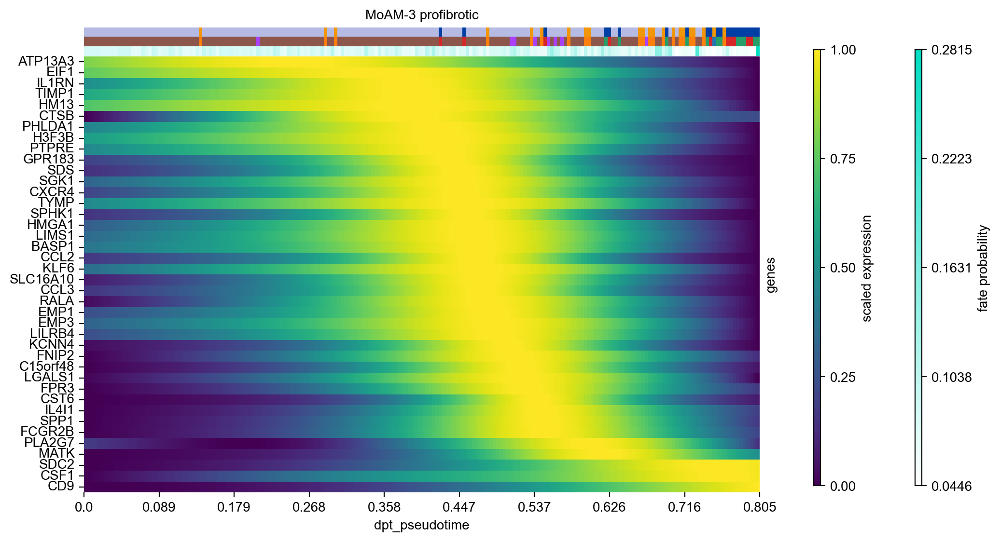

In [62]:
qqq = cellrank.pl.heatmap(
    myeloid_raw,
    model=model,
    lineages='MoAM-3 profibrotic',
    cluster_key=['cell_type', 'cell_type_state'],
    show_fate_probabilities=True,
    genes=moam_4_drivers.head(40).index,
    time_key='dpt_pseudotime',
    show_all_genes=True,
    n_convolve=1,
    return_figure=True,
)

Computing trends using `1` core(s)


100%|██████████| 40/40 [00:06<00:00,  5.94gene/s]

    Finish (0:00:06)



[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


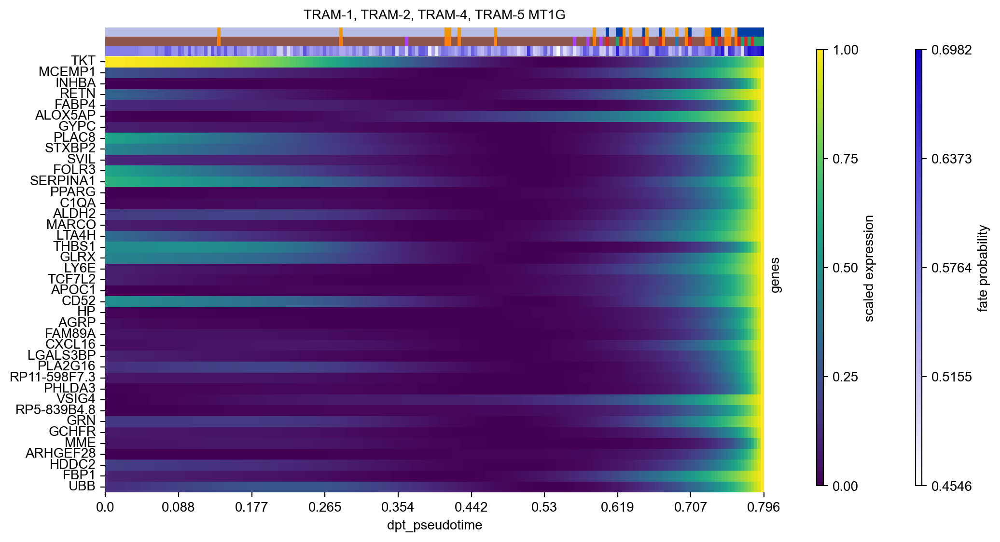

In [63]:
qqq = cellrank.pl.heatmap(
    myeloid_raw,
    model=model,
    lineages='TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G',
    cluster_key=['cell_type', 'cell_type_state'],
    show_fate_probabilities=True,
    genes=tram_drivers.head(40).index,
    time_key='dpt_pseudotime',
    show_all_genes=True,
    n_convolve=1,
    return_figure=True,
)

Big caveat about these plots: they show not gene expression, but the fitted model prediction of gene expression. The column metadata is pulled from the nearest cell by `dpt_pseudotime`

See https://github.com/theislab/cellrank/issues/1195

## Pseudobulk of fate probabilities

In [64]:
metadata_df = myeloid.obs[
    ['External Sample ID', 'cell_type', 'Status']
].groupby(['External Sample ID', 'cell_type', 'Status'], observed=True).size().reset_index(name='n_cells')

In [65]:
metadata_df = metadata_df.loc[metadata_df.n_cells.ge(10) & metadata_df.cell_type.isin([
    'Monocytes', 'MoAM-1', 'MoAM-2 mature'
])]

In [68]:
metadata_df.Status = metadata_df.Status.cat.reorder_categories(['Control', 'SSc-ILD'])
metadata_df.cell_type = metadata_df.cell_type.cat.remove_unused_categories().cat.reorder_categories([
    'Monocytes', 'MoAM-1', 'MoAM-2 mature'
])

In [69]:
pseudobulk = np.zeros((metadata_df.shape[0], myeloid.obsm['lineages_fwd'].shape[1]))
for i, (_, metadata_row) in enumerate(metadata_df.iterrows()):
    metadata_idx = (
        myeloid.obs.cell_type.eq(metadata_row.cell_type)
        & myeloid.obs['External Sample ID'].eq(metadata_row['External Sample ID'])
    )
    pseudobulk[i, :] = myeloid.obsm['lineages_fwd'][metadata_idx.to_numpy()].mean(axis=0)

In [70]:
pseudobulk = pd.DataFrame(pseudobulk, index=metadata_df.index, columns=myeloid.obsm['lineages_fwd']._names)

In [71]:
pseudobulk.shape

(65, 4)

In [72]:
sample_order = metadata_df.sort_values(
    ['Status', 'cell_type', 'External Sample ID']
).index

In [73]:
def plot_stats_boxplot(ax, df, value_col):
    stats_results = []
    for ct in df.cell_type.unique():
        vals1 = df[value_col][df.cell_type.eq(ct) & df.Status.eq('Control')]
        vals2 = df[value_col][df.cell_type.eq(ct) & df.Status.eq('SSc-ILD')]
        if vals1.size == 0 or vals2.size == 0:
            continue
        pval = scipy.stats.ttest_ind(vals1, vals2).pvalue
        stats_results.append([ct, 'Control', 'SSc-ILD', vals1.size, vals2.size, pval])

    stats_results = pd.DataFrame(
        stats_results,
        columns=['cell_type', 'group1', 'group2', 'group1_size', 'group2_size', 'pval']
    )
    stats_results['padj'] = statsmodels.stats.multitest.fdrcorrection(stats_results.pval)[1]
    stats_results_sign = stats_results.loc[stats_results.padj.lt(0.05)]

    sns.boxplot(
        data=df,
        x='cell_type',
        y=value_col,
        hue='Status',
        palette=['royalblue', 'firebrick'],
        saturation=1,
        showfliers=False,
        linecolor='k',
        ax=ax
    )
    sns.swarmplot(
        data=df,
        x='cell_type',
        y=value_col,
        hue='Status',
        dodge=True,
        palette=['k', 'k'],
        # jitter=0.2,
        legend=False,
        ax=ax
    )
    plotter = sns.categorical._CategoricalPlotter(
        data=df,
        variables=dict(x='cell_type', y=value_col, hue='Status')
    )
    plotter.scale_categorical(plotter.orient, order=None, formatter=None)
    plotter._attach(ax)

    start_height = df[value_col].max()
    incrementer = 15 # px
    q = ax.transData.inverted().transform([[0, 0], [0, incrementer]])
    y_offset = q[1][1] - q[0][1]
    gap = y_offset * 2
    y = start_height + gap
    for _, r in stats_results_sign.iterrows():
        p = f'$q={r.padj:.3f}$'

        # statistical annotation
        # Get x positions from Seaborn
        base_x = ax.xaxis.convert_units(r.cell_type)
        plotter_data = pd.DataFrame({plotter.orient: [base_x], "width": 0.8 * plotter._native_width})
        plotter._dodge({'hue': r.group1}, plotter_data)
        x1 = plotter_data[plotter.orient][0]
        plotter_data = pd.DataFrame({plotter.orient: [base_x], "width": 0.8 * plotter._native_width})
        plotter._dodge({'hue': r.group2}, plotter_data)
        x2 = plotter_data[plotter.orient][0]

        col = 'k'
        h = y_offset
        # y += gap

        bracket = ax.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1, c=col)
        txt = ax.text((x1+x2)*.5, y+1.1*h, p, ha='center', va='bottom', color=col, size=10)
        # y += y_offset

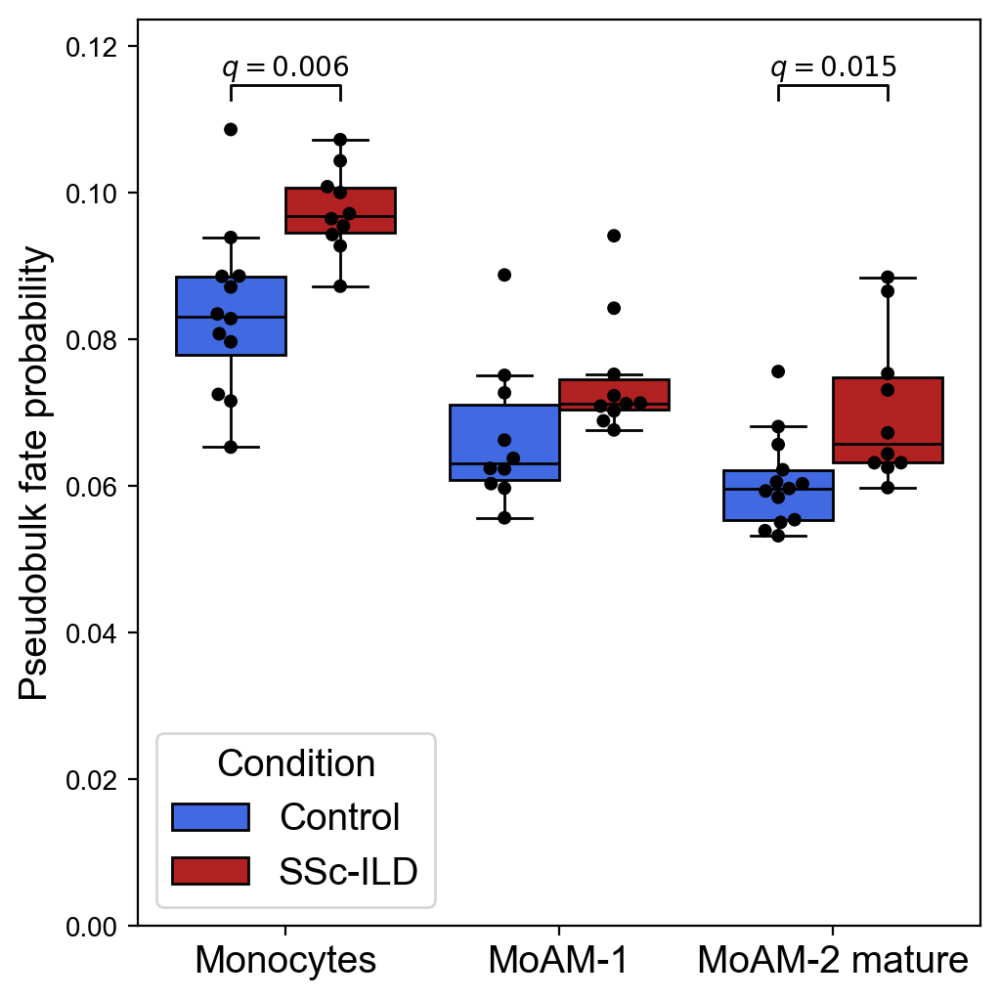

In [74]:
fig, ax = plt.subplots(figsize=(5, 5), constrained_layout=True)
LINEAGE = 'MoAM-3 profibrotic'
df = pseudobulk.merge(metadata_df, left_index=True, right_index=True)
plot_stats_boxplot(ax, df, LINEAGE)
# ax.set_title(f'Pseudobulk probability to reach {LINEAGE}', size=16)
ax.set_ylabel(f'Pseudobulk fate probability', size=14)
ax.set_xlabel('')
ax.tick_params(axis='x', labelsize=14)
ax.set_ylim(0, ax.get_ylim()[1] * 1.05)
h, l = ax.get_legend_handles_labels()
ax.legend(
    handles=h,
    labels=['Control', 'SSc-ILD'],
    loc='lower left',
    fontsize=14,
    title_fontsize=14,
    title='Condition'
)
# fig.savefig('00_figures/Figure_5E_fate_moam.pdf')

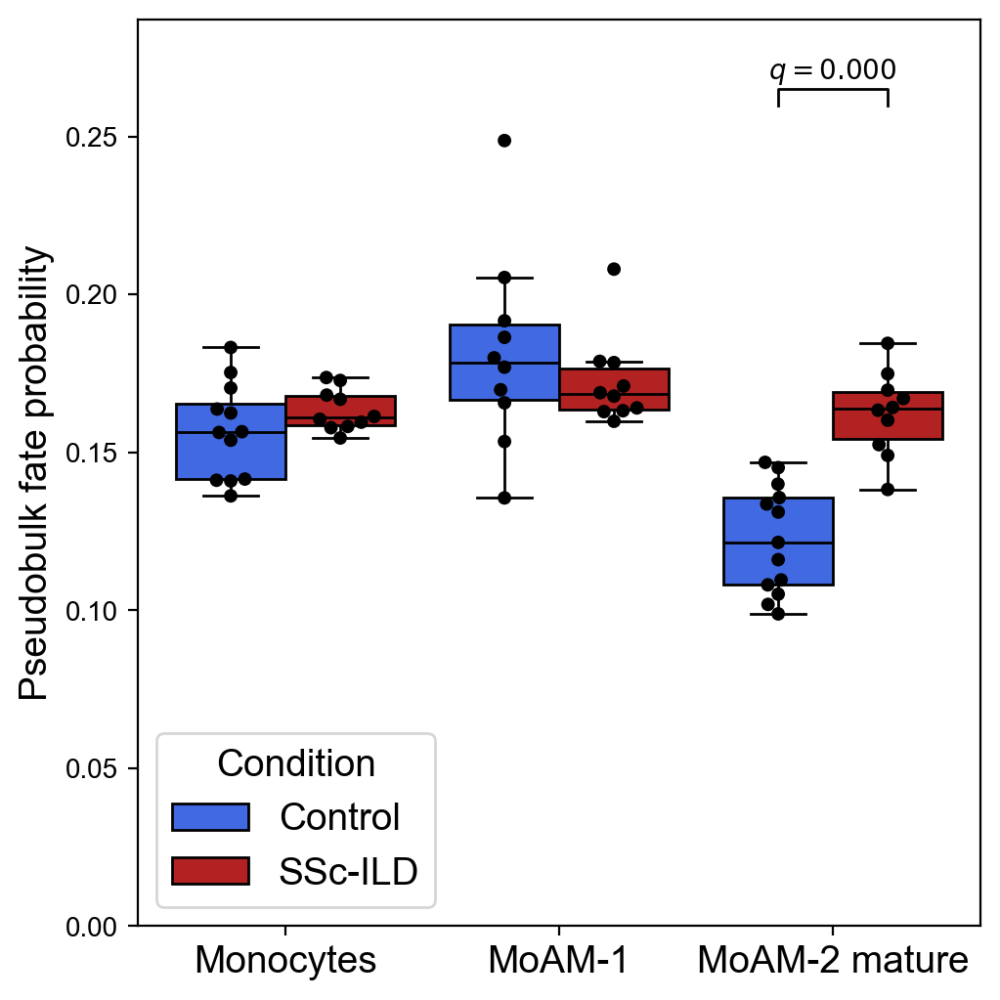

In [75]:
fig, ax = plt.subplots(figsize=(5, 5), constrained_layout=True)
LINEAGE = 'Interstitial macrophages'
df = pseudobulk.merge(metadata_df, left_index=True, right_index=True)
plot_stats_boxplot(ax, df, LINEAGE)
ax.set_ylabel(f'Pseudobulk fate probability', size=14)
ax.set_xlabel('')
ax.set_ylim(0, ax.get_ylim()[1] * 1.05)
ax.tick_params(axis='x', labelsize=14)
h, l = ax.get_legend_handles_labels()
ax.legend(
    handles=h,
    labels=['Control', 'SSc-ILD'],
    loc='lower left',
    fontsize=14,
    title_fontsize=14,
    title='Condition'
)
# fig.savefig('00_figures/Figure_S5B_fate_im.pdf')

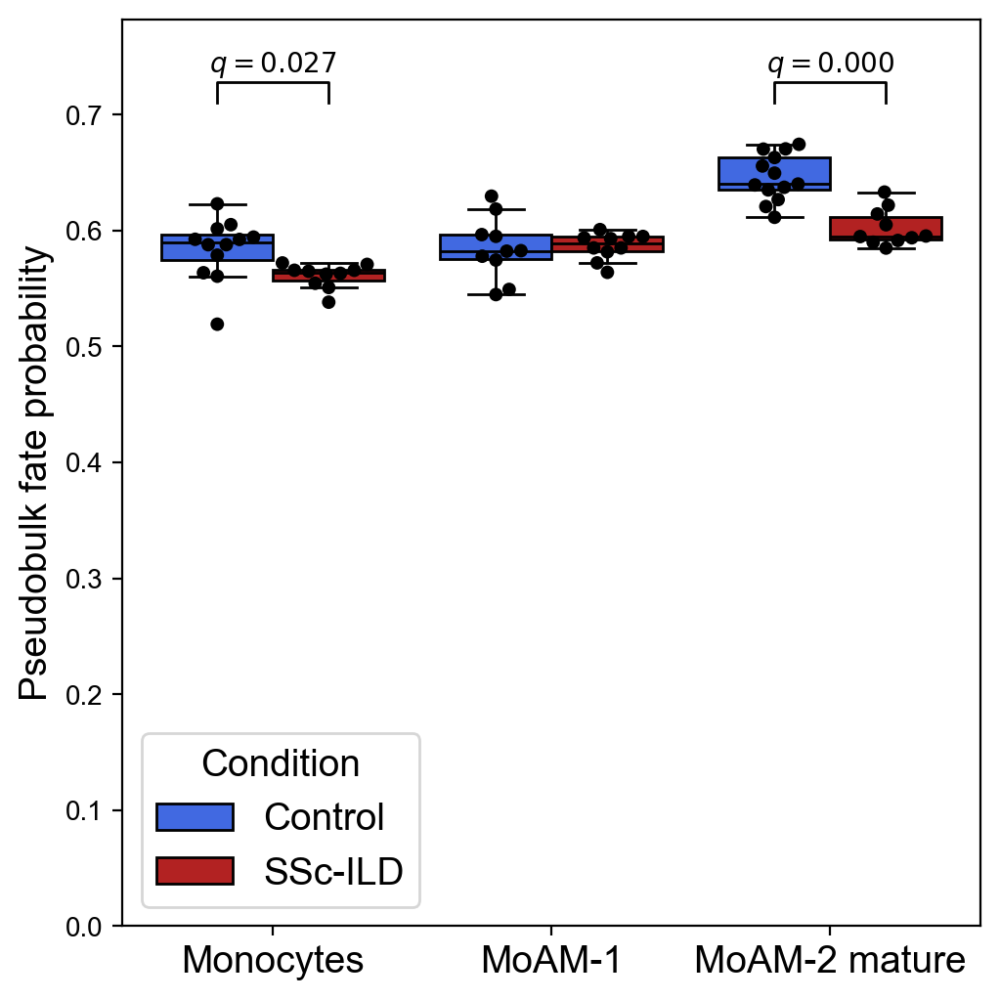

In [76]:
fig, ax = plt.subplots(figsize=(5, 5), constrained_layout=True)
LINEAGE = 'TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G'
df = pseudobulk.merge(metadata_df, left_index=True, right_index=True)
ax.set_ylim(0, df[LINEAGE].max() * 0.8)
plot_stats_boxplot(ax, df, LINEAGE)
ax.set_ylabel(f'Pseudobulk fate probability', size=14)
ax.set_xlabel('')
ax.tick_params(axis='x', labelsize=14)
ax.set_ylim(0, ax.get_ylim()[1] * 1.45)
h, l = ax.get_legend_handles_labels()
ax.legend(
    handles=h,
    labels=['Control', 'SSc-ILD'],
    loc='lower left',
    fontsize=14,
    title_fontsize=14,
    title='Condition'
)
# fig.savefig('00_figures/Figure_5F_fate_tram.pdf')

## Save object

In [77]:
myeloid.write_h5ad('../../data/31_bal-object/13_cellrank/13_cellrank.h5ad')

In [78]:
g.write('../../data/31_bal-object/13_cellrank/13_cellrank.gpcca.pickle')

Writing `GPCCA[kernel=PseudotimeKernel[n=150801], initial_states=None, terminal_states=['Interstitial macrophages', 'MoAM-3 profibrotic', 'TRAM-1, TRAM-2, TRAM-4, TRAM-5 MT1G', 'TRAM-6 activated']]` to `../../data/31_bal-object/13_cellrank/13_cellrank.gpcca.pickle`


# Analyze terminal states separately

## Healthy controls

In [66]:
myeloid_hc = myeloid[myeloid.obs.Status.eq('control'), :].copy()

In [67]:
del myeloid_hc.uns['iroot']

In [68]:
sc.pp.neighbors(myeloid_hc, use_rep='X_scVI')

In [69]:
sc.tl.diffmap(myeloid_hc)

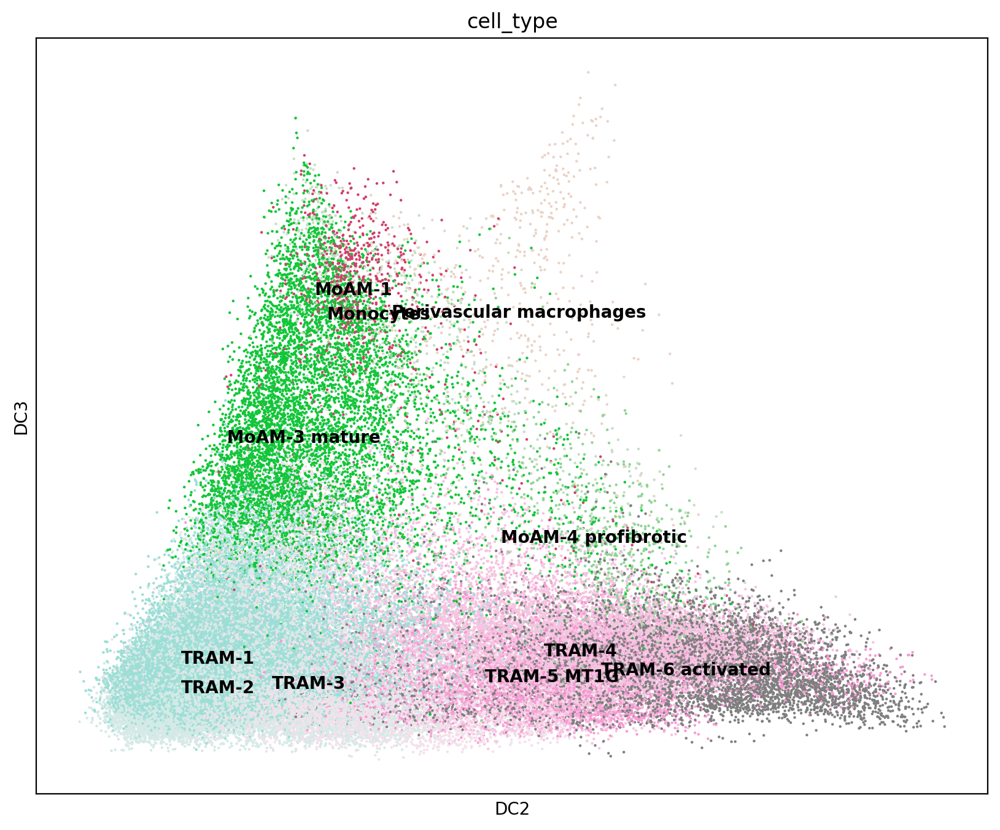

In [70]:
sc.pl.diffmap(myeloid_hc, color=["cell_type"], dimensions=(1, 2), size=10, legend_loc="on data")

Diffusion components are not straightforward, especially 2 & 3

DC3 seems to be Monocyte to TRAM differentiation, while DC2 seems to be a sort of activation.

Let's take most extreme Monocyte with the max DC3, and use it as root

In [71]:
root_idx = myeloid_hc.obsm['X_diffmap'][myeloid_hc.obs.cell_type.eq('Monocytes'), 2].argmax()

In [72]:
root_idx = np.where(myeloid_hc.obs.cell_type.eq('Monocytes'))[0][root_idx]

In [73]:
myeloid_hc.obs.cell_type[root_idx]

'Monocytes'

In [74]:
myeloid_hc.uns['iroot'] = root_idx

## Pseudotime

In [75]:
sc.tl.dpt(myeloid_hc)

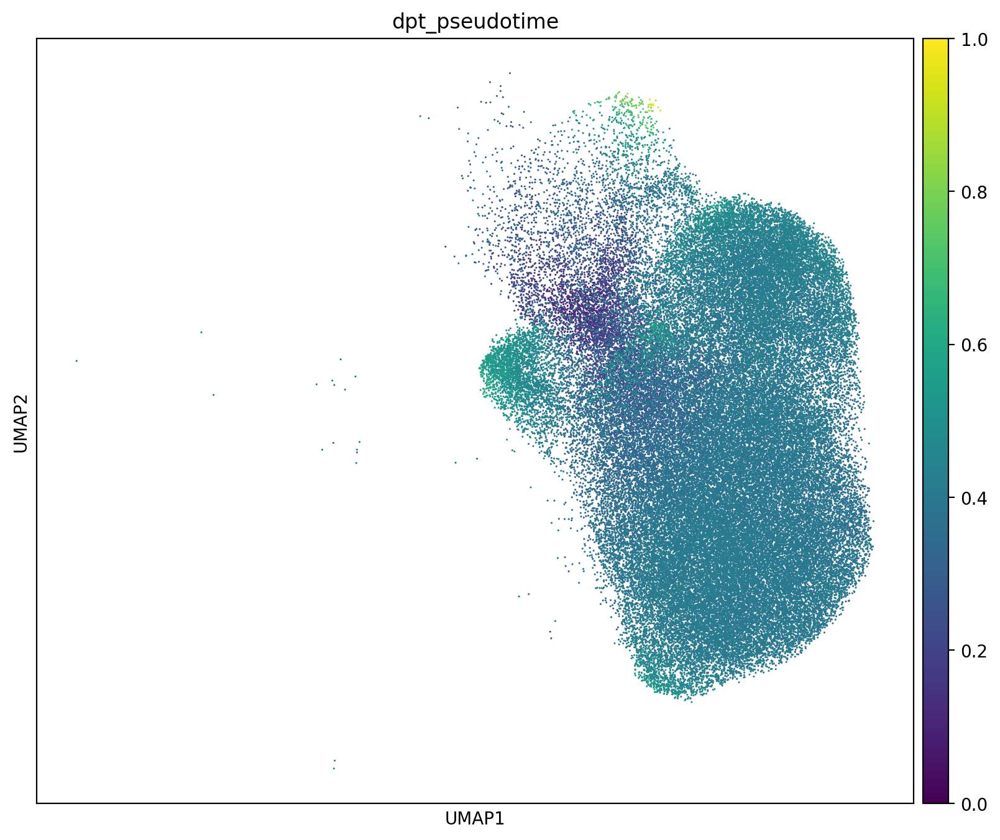

In [76]:
sc.pl.umap(myeloid_hc, color='dpt_pseudotime', size=5)

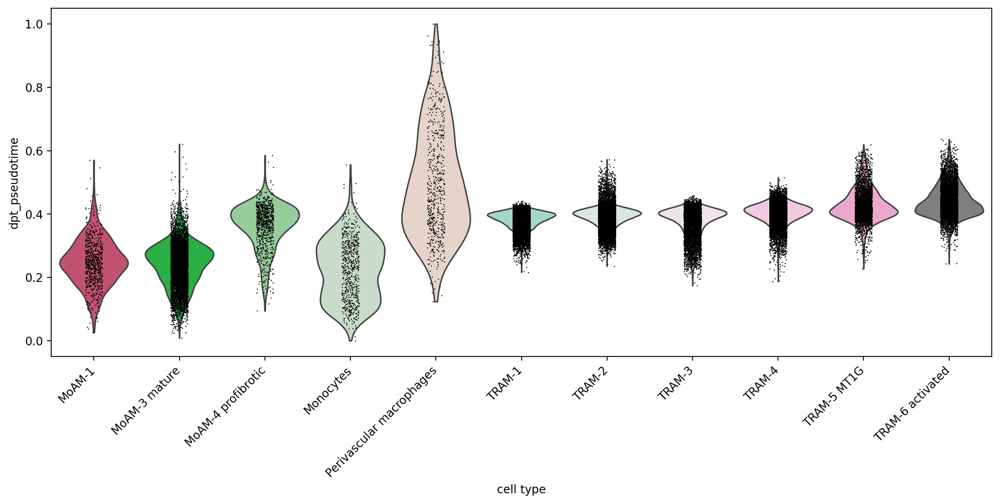

In [77]:
fig, ax = plt.subplots(figsize=(12, 6), constrained_layout=True)
sc.pl.violin(myeloid_hc, keys='dpt_pseudotime', groupby='cell_type', ax=ax, show=False)
trans = mpl.transforms.Affine2D().translate(8, 0)
for t in ax.get_xticklabels():
    t.set_rotation(45)
    t.set_ha('right')
    t.set_transform(t.get_transform() + trans)

This pseudotime seems suboptimal, because the most change is in Monocytes, and sparse along the `0–0.5` range, and `0.9–1` range is exclusively Perivascular macrophages.

However, we will work with this right now, because exploring other pseudotime algorithms (see https://www.nature.com/articles/s41587-019-0071-9) is time-consuming.

## Cellrank transition kernel based on pseudotime

In [78]:
pk = cellrank.kernels.PseudotimeKernel(myeloid_hc, time_key='dpt_pseudotime')
pk.compute_transition_matrix()

Computing transition matrix based on pseudotime


100%|██████████| 77881/77881 [00:14<00:00, 5228.27cell/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


    Finish (0:00:17)


PseudotimeKernel[n=77881, dnorm=False, scheme='hard', frac_to_keep=0.3]

Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:19)


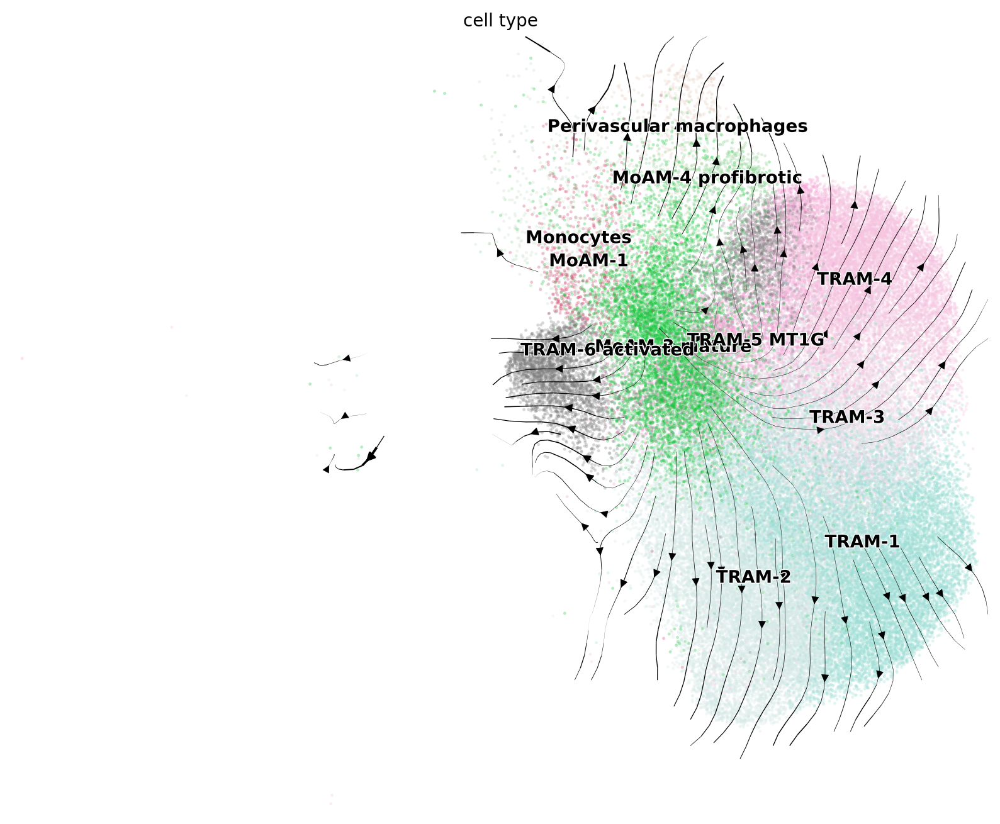

In [79]:
pk.plot_projection(basis='umap', color='cell_type', recompute=True)

## Coarse-graining the transition matrix

In [80]:
g = cellrank.estimators.GPCCA(pk)
print(g)

GPCCA[kernel=PseudotimeKernel[n=77881], initial_states=None, terminal_states=None]


In [81]:
g.compute_schur(n_components=40)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[22, 31, 34, 38]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:44)


GPCCA[kernel=PseudotimeKernel[n=77881], initial_states=None, terminal_states=None]

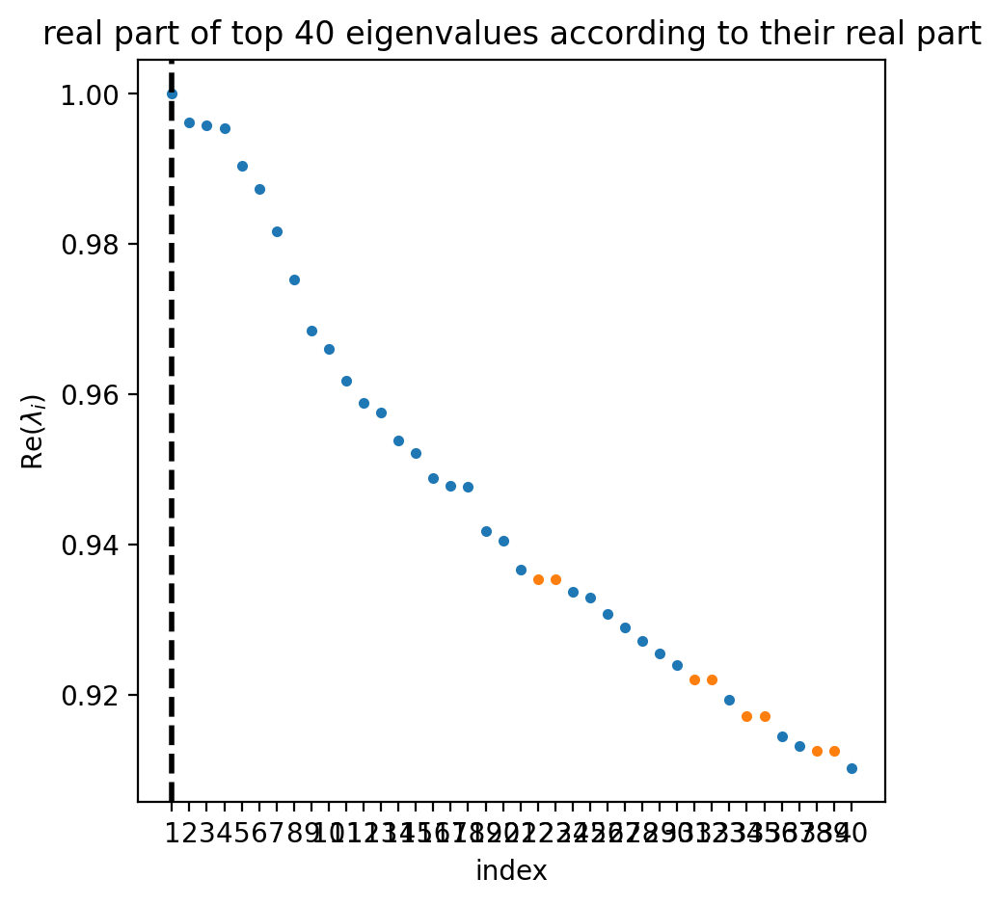

In [82]:
g.plot_spectrum(real_only=True)

Here we select 4 macrostates (eigenvalues), because of the (relatively) large gap after it.

In [83]:
g.compute_macrostates(n_states=4, cluster_key='cell_type', n_cells=100)

Computing `4` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:09)


GPCCA[kernel=PseudotimeKernel[n=77881], initial_states=None, terminal_states=None]

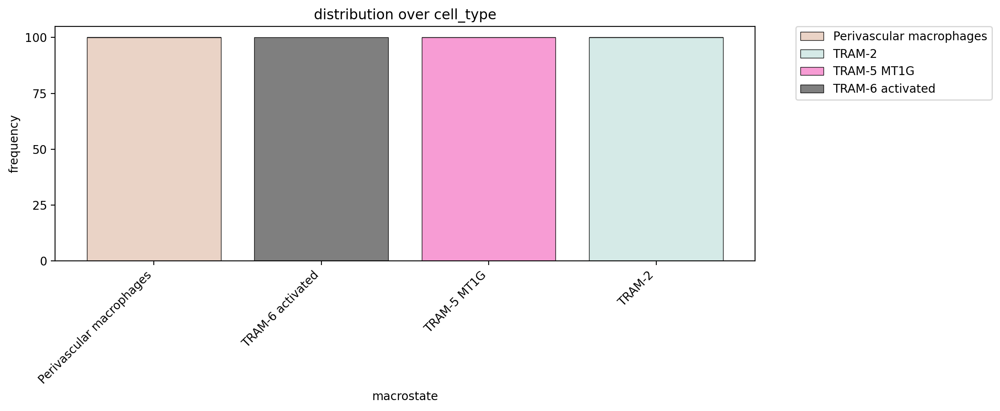

In [84]:
g.plot_macrostate_composition(key='cell_type', figsize=(12, 5))

In [85]:
g.predict_terminal_states(n_cells=100)

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


GPCCA[kernel=PseudotimeKernel[n=77881], initial_states=None, terminal_states=['Perivascular macrophages', 'TRAM-2', 'TRAM-5 MT1G', 'TRAM-6 activated']]

/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c

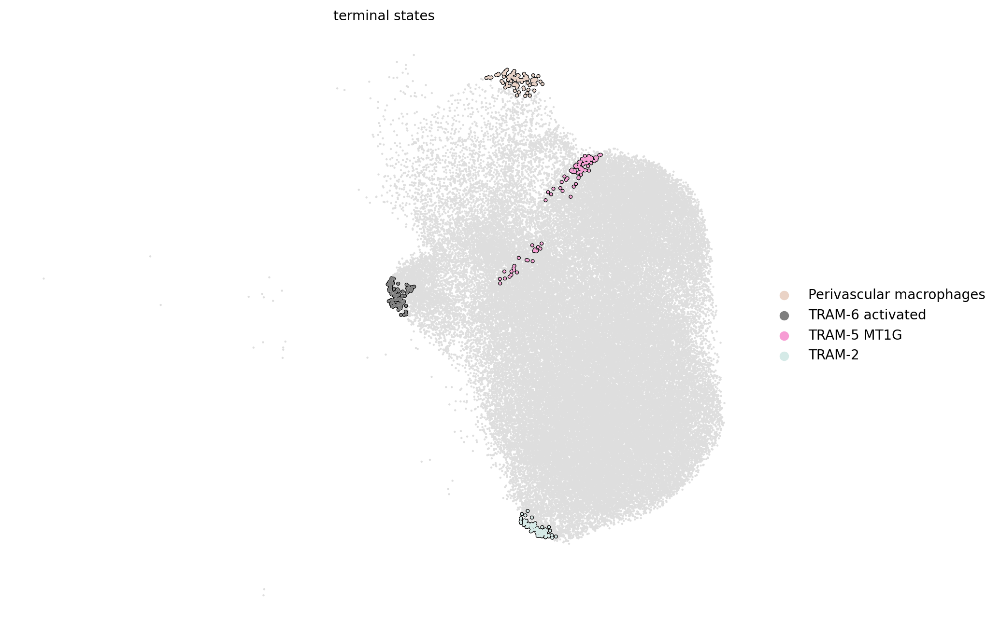

In [86]:
g.plot_macrostates(which='terminal', legend_loc='right', s=10)

## SSc

In [87]:
myeloid_ssc = myeloid[myeloid.obs.Status.eq('SSc'), :].copy()

In [88]:
del myeloid_ssc.uns['iroot']

In [89]:
sc.pp.neighbors(myeloid_ssc, use_rep='X_scVI')

In [90]:
sc.tl.diffmap(myeloid_ssc)

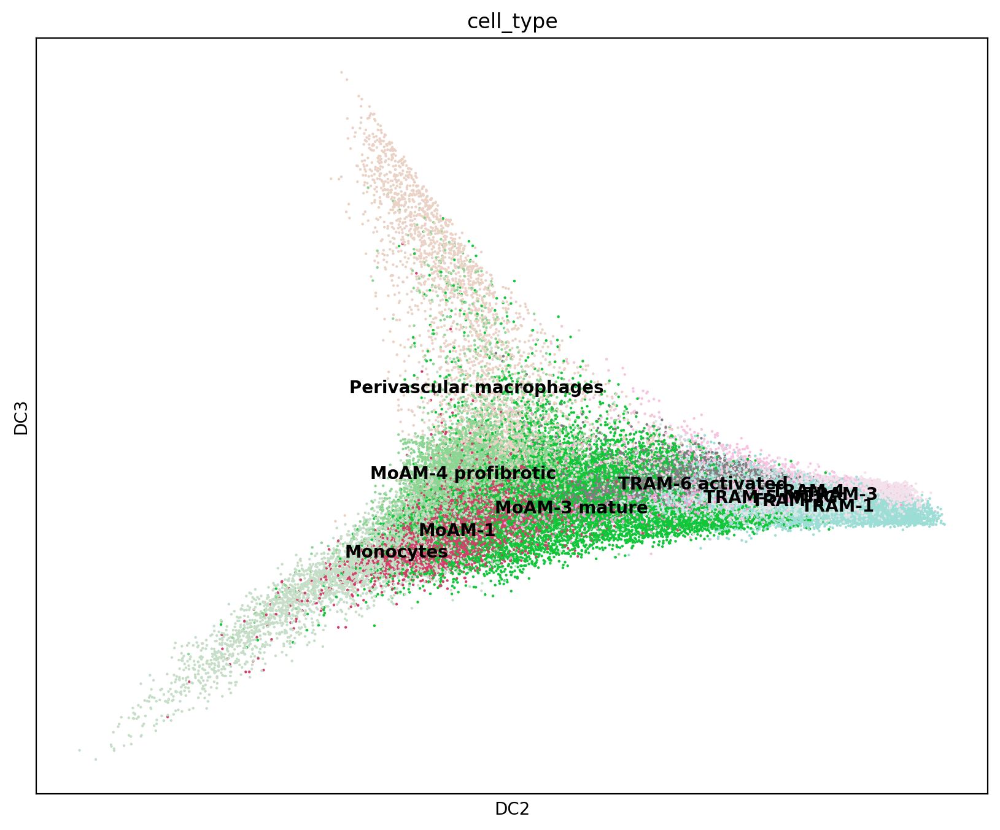

In [91]:
sc.pl.diffmap(myeloid_ssc, color=["cell_type"], dimensions=(1, 2), size=10, legend_loc="on data")

Diffusion components are not straightforward, especially 2 & 3

DC2 seems to be Monocyte to TRAM differentiation, while DC3 seems to be perivascular macrophages

Let's take most extreme Monocyte with the min DC2, and use it as root

In [92]:
root_idx = myeloid_ssc.obsm['X_diffmap'][:, 1].argmin()

In [93]:
myeloid_ssc.obs.cell_type[root_idx]

'Monocytes'

In [94]:
myeloid_ssc.uns['iroot'] = root_idx

## Pseudotime

In [95]:
sc.tl.dpt(myeloid_ssc)

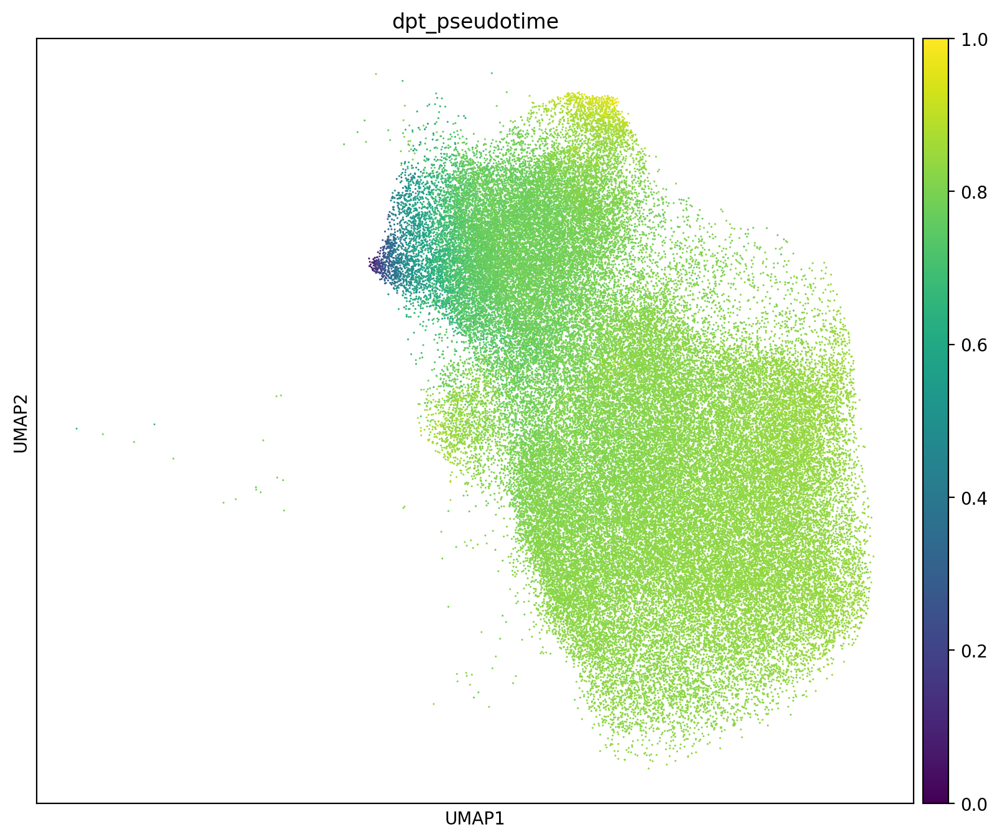

In [96]:
sc.pl.umap(myeloid_ssc, color='dpt_pseudotime', size=5)

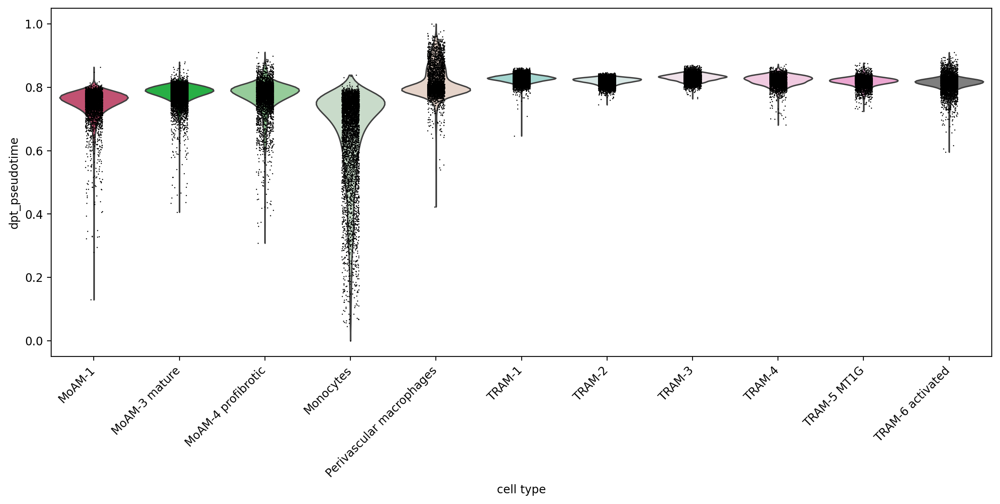

In [97]:
fig, ax = plt.subplots(figsize=(12, 6), constrained_layout=True)
sc.pl.violin(myeloid_ssc, keys='dpt_pseudotime', groupby='cell_type', ax=ax, show=False)
trans = mpl.transforms.Affine2D().translate(8, 0)
for t in ax.get_xticklabels():
    t.set_rotation(45)
    t.set_ha('right')
    t.set_transform(t.get_transform() + trans)

This pseudotime seems suboptimal, because the most change is in Monocytes, and sparse along the `0–0.5` range, and `0.9–1` range is exclusively Perivascular macrophages.

However, we will work with this right now, because exploring other pseudotime algorithms (see https://www.nature.com/articles/s41587-019-0071-9) is time-consuming.

## Cellrank transition kernel based on pseudotime

In [98]:
pk = cellrank.kernels.PseudotimeKernel(myeloid_ssc, time_key='dpt_pseudotime')
pk.compute_transition_matrix()

Computing transition matrix based on pseudotime


100%|██████████| 72920/72920 [00:14<00:00, 5115.40cell/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


    Finish (0:00:16)


PseudotimeKernel[n=72920, dnorm=False, scheme='hard', frac_to_keep=0.3]

Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:18)


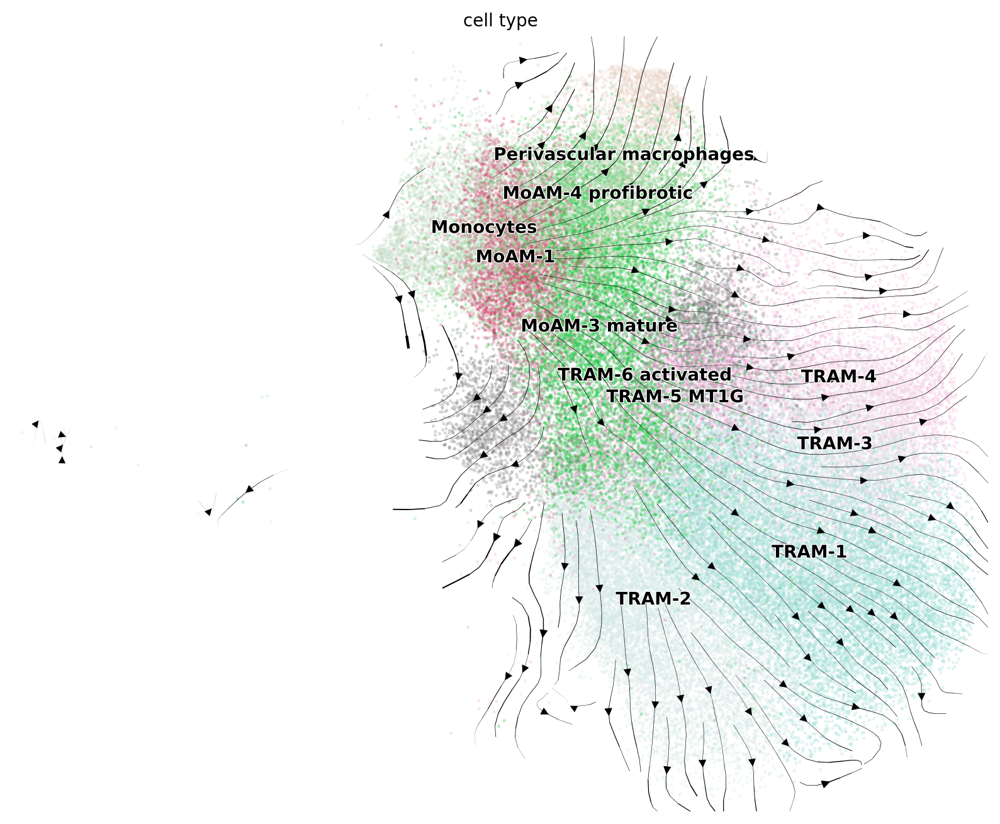

In [99]:
pk.plot_projection(basis='umap', color='cell_type', recompute=True)

## Coarse-graining the transition matrix

In [100]:
g = cellrank.estimators.GPCCA(pk)
print(g)

GPCCA[kernel=PseudotimeKernel[n=72920], initial_states=None, terminal_states=None]


In [101]:
g.compute_schur(n_components=40)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[19, 24, 35, 37, 39]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:01:00)


GPCCA[kernel=PseudotimeKernel[n=72920], initial_states=None, terminal_states=None]

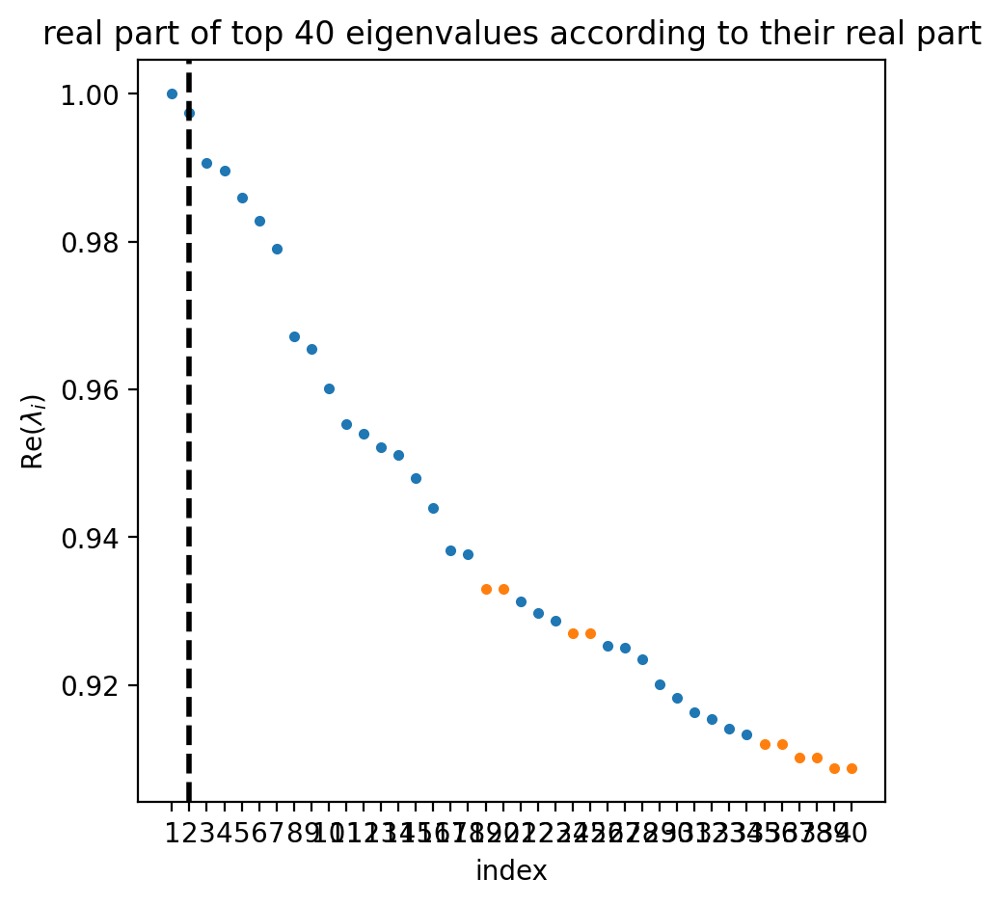

In [102]:
g.plot_spectrum(real_only=True)

Here we select 4 macrostates (eigenvalues), because of the (relatively) large gap after it.

In [103]:
g.compute_macrostates(n_states=4, cluster_key='cell_type', n_cells=100)

Computing `4` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:03)


GPCCA[kernel=PseudotimeKernel[n=72920], initial_states=None, terminal_states=None]

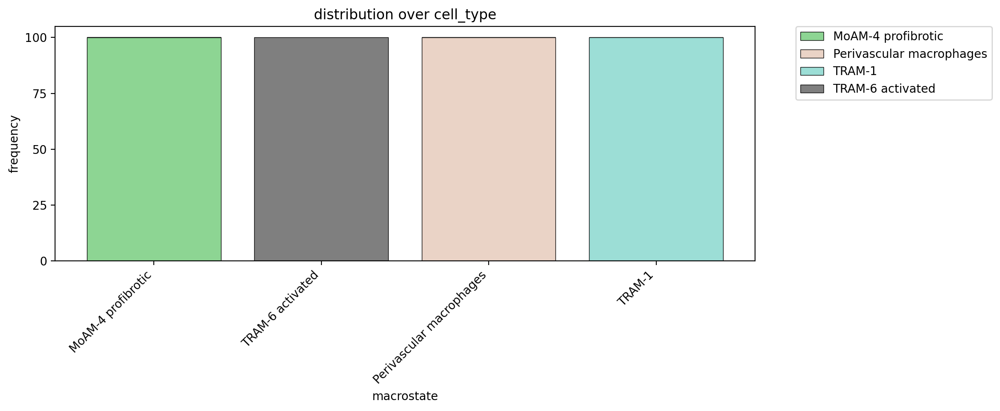

In [104]:
g.plot_macrostate_composition(key='cell_type', figsize=(12, 5))

In [105]:
g.predict_terminal_states(n_cells=100)

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


GPCCA[kernel=PseudotimeKernel[n=72920], initial_states=None, terminal_states=['MoAM-4 profibrotic', 'Perivascular macrophages', 'TRAM-1', 'TRAM-6 activated']]

/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/projects/b1038/Pulmonary/nmarkov/ssc-v2/code/cellrank_venv/lib/python3.11/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c

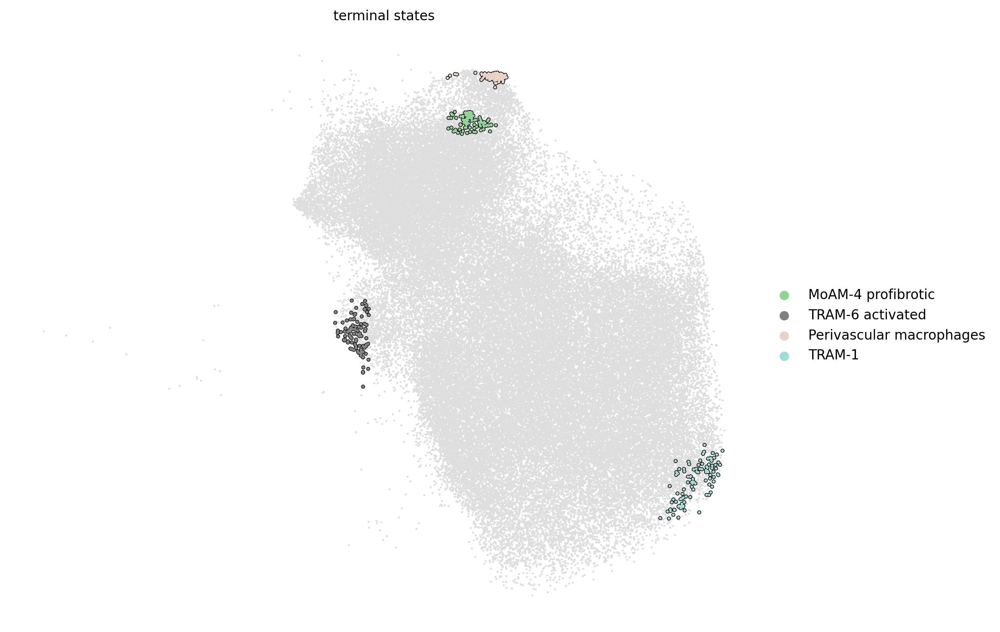

In [106]:
g.plot_macrostates(which='terminal', legend_loc='right', s=10)